# Rainfall Prediction- Weather Forecasting

**Problem Statement:**


Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change.


Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. Here, I will predict two things:
  
1. Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.
1.  Design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there.



# Importing Basic Libraries and Loading the Dataset

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv('weather.csv') 
pd.set_option('display.max_columns',None)
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


# Exploratory Data Analysis

## 1- Data Exploration

In [3]:
#checking the shape of dataset
df.shape

(8425, 23)

We have 8425 rows and 23 Columns

In [4]:
#checking the columns of the dataset

df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

### Variable Description:

1. Date  - The date of observation

1. Location  -The common name of the location of the weather station

1. MinTemp  -The minimum temperature in degrees celsius

1. MaxTemp -The maximum temperature in degrees celsius

1. Rainfall  -The amount of rainfall recorded for the day in mm

1. Evaporation  -The so-called Class A pan evaporation (mm) in the 24 hours to 9am

1. Sunshine  -The number of hours of bright sunshine in the day.

1. WindGustDir- The direction of the strongest wind gust in the 24 hours to midnight

1. WindGustSpeed -The speed (km/h) of the strongest wind gust in the 24 hours to midnight

1. WindDir9am -Direction of the wind at 9am

1. WindDir3pm -Direction of the wind at 3pm

1. WindSpeed9am -Wind speed (km/hr) averaged over 10 minutes prior to 9am

1. WindSpeed3pm -Wind speed (km/hr) averaged over 10 minutes prior to 3pm

1. Humidity9am -Humidity (percent) at 9am

1. Humidity3pm -Humidity (percent) at 3pm

1. Pressure9am -Atmospheric pressure (hpa) reduced to mean sea level at 9am

1. Pressure3pm -Atmospheric pressure (hpa) reduced to mean sea level at 3pm

1. Cloud9am - Fraction of sky obscured by cloud at 9am. 

1. Cloud3pm -Fraction of sky obscured by cloud 

1. Temp9am-Temperature (degrees C) at 9am

1. Temp3pm -Temperature (degrees C) at 3pm

1. RainToday -Boolean: 1 if precipitation (mm) in the 24 hours to 9am exceeds 1mm, otherwise 0

1. RainTomorrow -The amount of next day rain in mm. Used to create response variable . A kind of measure of the "risk".



In [5]:
#Lets check the info of dataset

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8350 non-null   float64
 3   MaxTemp        8365 non-null   float64
 4   Rainfall       8185 non-null   float64
 5   Evaporation    4913 non-null   float64
 6   Sunshine       4431 non-null   float64
 7   WindGustDir    7434 non-null   object 
 8   WindGustSpeed  7434 non-null   float64
 9   WindDir9am     7596 non-null   object 
 10  WindDir3pm     8117 non-null   object 
 11  WindSpeed9am   8349 non-null   float64
 12  WindSpeed3pm   8318 non-null   float64
 13  Humidity9am    8366 non-null   float64
 14  Humidity3pm    8323 non-null   float64
 15  Pressure9am    7116 non-null   float64
 16  Pressure3pm    7113 non-null   float64
 17  Cloud9am       6004 non-null   float64
 18  Cloud3pm

We have 7 Object type and 16 Float type in the dataset. 
We can see few missing values are present.

In [6]:
#Lets check if there are Null values

df.isnull().sum()

Date                0
Location            0
MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustDir       991
WindGustSpeed     991
WindDir9am        829
WindDir3pm        308
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
RainToday         240
RainTomorrow      239
dtype: int64

There are many missing values in our dataset. lets check the unique values 

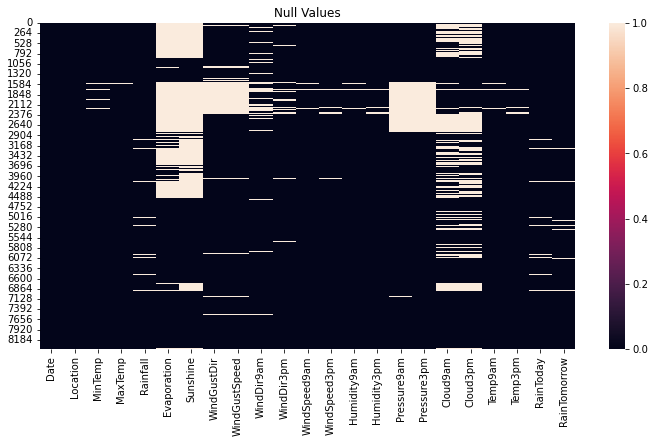

In [7]:
#Visualizing null values

plt.figure(figsize=[12,6])
sns.heatmap(df.isnull())
plt.title("Null Values")
plt.show()

Heatmap clearly shows the missing values present in each features. We can see that except for Date and Location all others have missing data

In [8]:
#checking the unique value counts of each feature

df.nunique()

Date             3004
Location           12
MinTemp           285
MaxTemp           331
Rainfall          250
Evaporation       116
Sunshine          140
WindGustDir        16
WindGustSpeed      52
WindDir9am         16
WindDir3pm         16
WindSpeed9am       34
WindSpeed3pm       35
Humidity9am        90
Humidity3pm        94
Pressure9am       384
Pressure3pm       374
Cloud9am            9
Cloud3pm            9
Temp9am           304
Temp3pm           328
RainToday           2
RainTomorrow        2
dtype: int64

We have no columns with a single unique feature or completer unique values.

In [9]:
#lets check each data types

df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

* Date, Location, WindGustDir, WindDir9am,WindDir3pm,RainToday,RainTomorrow are object datatypes 
* MinTemp, MaxTemp, Rainfall, Evaporation, Sunshine, WindGustSpeed, WindSpeed9am, WindSpeed3pm, Humidity9am, Humidity3pm, Pressure9am, Pressure3pm, Cloud9am, Cloud3pm, Temp9am, Temp3pm are Float type.

In [10]:
#lets divide columns into categorical and numerical columns.

cat_cols=[]
for i in df.dtypes.index:
    if df.dtypes[i]=='object':
        cat_cols.append(i)
print(cat_cols)

['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']


In [11]:
# Now checking for numerical columns
num_cols=[]
for i in df.dtypes.index:
    if df.dtypes[i]!='object':
        num_cols.append(i)
print(num_cols)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']


In [12]:
#lets check value counts of categorical column

for i in df[cat_cols]:
    print(df[i].value_counts())
    print('*********************************************************************')
    print("               ")


2011-01-31    5
2011-05-08    5
2011-05-21    5
2011-05-20    5
2011-05-19    5
             ..
2013-01-28    1
2013-01-29    1
2013-01-30    1
2013-01-31    1
2013-06-08    1
Name: Date, Length: 3004, dtype: int64
*********************************************************************
               
Melbourne       1622
Williamtown     1230
PerthAirport    1204
Albury           907
Newcastle        822
CoffsHarbour     611
Brisbane         579
Penrith          482
Wollongong       474
Darwin           250
Adelaide         205
Uluru             39
Name: Location, dtype: int64
*********************************************************************
               
N      713
SSE    578
S      577
SW     572
E      557
WNW    531
W      507
WSW    504
SE     484
ENE    415
SSW    396
NW     383
NE     353
NNE    343
ESE    302
NNW    219
Name: WindGustDir, dtype: int64
*********************************************************************
               
N      906
SW     704
NW     625
WSW  

**Observations:**

* We have different date data and maximum value counts for a particular date is 5.
* We have 12 Locations mentioned in this dataset.
* We have 16 unique directions for WindgustDir, windDir3pm andWindDir9am.
* N is the top value for WindGustDir and WindDir9am.
* SE is the top value for WindDir3pm
* We have more number of No in Rainfall today and Tomorrow.

In [13]:
#lets check value counts of numerical values

for i in df[num_cols]:
    print(df[i].value_counts().sort_index())
    print('****************************************************************************')
    print("               ")



-2.0     2
-1.7     1
-1.5     1
-1.4     1
-1.3     2
        ..
 27.5    2
 27.8    1
 28.0    1
 28.3    1
 28.5    1
Name: MinTemp, Length: 285, dtype: int64
****************************************************************************
               
8.2     1
8.3     1
8.4     1
8.8     2
9.4     1
       ..
43.5    1
43.6    2
44.8    1
44.9    1
45.5    2
Name: MaxTemp, Length: 331, dtype: int64
****************************************************************************
               
0.0      5299
0.1        28
0.2       406
0.4       177
0.5         7
         ... 
142.2       1
168.4       1
225.0       2
240.0       1
371.0       1
Name: Rainfall, Length: 250, dtype: int64
****************************************************************************
               
0.0      12
0.2      36
0.4      24
0.6      47
0.7       1
         ..
37.0      2
47.0      2
55.4      2
59.2      2
145.0     2
Name: Evaporation, Length: 116, dtype: int64
***********************************

**Observations:**
    
* We have MinTemp from -2 to 28.5 and MaxTemp from 8.2 to 45.5 degree celsius
* We have Rainfall of 0 to 371 and Evaporation of 0 to 145 mm.
* We have bright Sunshine hours from 0 to 13.9 hours.
* We have strong wind(windGustspeed) from 7 to 107 km/h.
* We have morning wind speed from 0 to 63 and evening wind speed of 0 to 83 km/h
* We have morning humidity of 10 to 100 and evening humidity of 6 to 99 Percent.
* We have morning temp of 1.9 to 39.4 and evening temp of 7.3 to 44.1 degree celsius.

## 2- Feature Engineering

#### Date is in Object format. So we can change it to Day, Month and Year.

In [14]:
import datetime as dt

df["Date"]=pd.to_datetime(df["Date"])
#Extracting Year, month and date from Date column

df["Year"]=df["Date"].dt.year
df["Month"]=df["Date"].dt.month
df["Day"]=df["Date"].dt.day

In [15]:
#lets drop Date column

#Droping Date column
df = df.drop(["Date"],axis=1)

In [16]:
#checking unique values for Day

df["Day"].value_counts().sort_index()

1     275
2     275
3     275
4     275
5     275
6     276
7     277
8     277
9     277
10    278
11    278
12    278
13    277
14    276
15    276
16    276
17    276
18    277
19    277
20    280
21    280
22    280
23    280
24    280
25    280
26    274
27    274
28    275
29    256
30    250
31    165
Name: Day, dtype: int64

In [17]:
#checking unique values for month

df["Month"].value_counts().sort_index()

1     753
2     620
3     761
4     600
5     801
6     818
7     732
8     682
9     609
10    655
11    653
12    741
Name: Month, dtype: int64

In [18]:
#checking unique values for Year

df["Year"].value_counts().sort_index()

2008      93
2009    1238
2010    1443
2011    1468
2012     905
2013     543
2014     959
2015     653
2016     732
2017     391
Name: Year, dtype: int64

* We have days from 1 to 31, months from 1 to 12 and Year from 2008 to 2017
* We have more number of Data of 2011 followed by 2010 and least data of year 2008

## Imputation Method to Replace Nan Values

In [19]:
#lets check skewness of the data to finalize imputation with mean or median

df.skew()

MinTemp          -0.089588
MaxTemp           0.379297
Rainfall         13.028837
Evaporation      10.710605
Sunshine         -0.519717
WindGustSpeed     0.711103
WindSpeed9am      0.956250
WindSpeed3pm      0.491069
Humidity9am      -0.255843
Humidity3pm       0.117563
Pressure9am      -0.022133
Pressure3pm      -0.009385
Cloud9am         -0.309417
Cloud3pm         -0.232598
Temp9am          -0.014699
Temp3pm           0.395061
Year              0.418663
Month             0.039388
Day               0.004260
dtype: float64

**We have skewness present in Rainfall, Evaporation,WindGustSpeed and WindSpeed9am. we can replace it with median and rest all with mean**

In [20]:
#lets see the null values in numerical columns again

df[num_cols].isnull().sum()

MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustSpeed     991
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
dtype: int64

In [21]:
#Replacing nan values in columns having skewness

df["Rainfall"] = df["Rainfall"].fillna(df["Rainfall"].median())
df["Evaporation"] = df["Evaporation"].fillna(df["Evaporation"].median())
df["WindGustSpeed"] = df["WindGustSpeed"].fillna(df["WindGustSpeed"].median())
df["WindSpeed9am"] = df["WindSpeed9am"].fillna(df["WindSpeed9am"].median())

In [22]:
#Replacing nan values in columns without skewness

df["MinTemp"] = df["MinTemp"].fillna(df["MinTemp"].mean())
df["MaxTemp"] = df["MaxTemp"].fillna(df["MaxTemp"].mean())
df["Sunshine"] = df["Sunshine"].fillna(df["Sunshine"].mean())
df["WindSpeed3pm"] = df["WindSpeed3pm"].fillna(df["WindSpeed3pm"].mean())
df["Humidity9am"] = df["Humidity9am"].fillna(df["Humidity9am"].mean())
df["Humidity3pm"] = df["Humidity3pm"].fillna(df["Humidity3pm"].mean())
df["Pressure9am"] = df["Pressure9am"].fillna(df["Pressure9am"].mean())
df["Pressure3pm"] = df["Pressure3pm"].fillna(df["Pressure3pm"].mean())
df["Cloud9am"] = df["Cloud9am"].fillna(df["Cloud9am"].mean())
df["Cloud3pm"] = df["Cloud3pm"].fillna(df["Cloud3pm"].mean())
df["Temp9am"] = df["Temp9am"].fillna(df["Temp9am"].mean())
df["Temp3pm"] = df["Temp3pm"].fillna(df["Temp3pm"].mean())

In [23]:
cat_cols=['Location',
 'WindGustDir',
 'WindDir9am',
 'WindDir3pm',
 'RainToday',
 'RainTomorrow']

In [24]:
#lets see the null values in categorical columns again
cat_cols=['Location','WindGustDir','WindDir9am','WindDir3pm','RainToday','RainTomorrow']
df[cat_cols].isnull().sum()

Location          0
WindGustDir     991
WindDir9am      829
WindDir3pm      308
RainToday       240
RainTomorrow    239
dtype: int64

In [25]:
#Replacing null values in categorical column with mode()

df["WindGustDir"] = df["WindGustDir"].fillna(df["WindGustDir"].mode()[0])
df["WindDir9am"] = df["WindDir9am"].fillna(df["WindDir9am"].mode()[0])
df["WindDir3pm"] = df["WindDir3pm"].fillna(df["WindDir3pm"].mode()[0])
df["RainToday"] = df["RainToday"].fillna(df["RainToday"].mode()[0])
df["RainTomorrow"] = df["RainTomorrow"].fillna(df["RainTomorrow"].mode()[0])

In [26]:
#lets check the null value if any:

df.isnull().sum()

Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
Year             0
Month            0
Day              0
dtype: int64

#### Our data is free from null values.

In [27]:
#new dataset

df

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,Albury,13.4,22.900000,0.6,4.6,7.632205,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,No,No,2008,12,1
1,Albury,7.4,25.100000,0.0,4.6,7.632205,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,No,No,2008,12,2
2,Albury,12.9,25.700000,0.0,4.6,7.632205,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,No,No,2008,12,3
3,Albury,9.2,28.000000,0.0,4.6,7.632205,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,No,No,2008,12,4
4,Albury,17.5,32.300000,1.0,4.6,7.632205,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,No,No,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,Uluru,2.8,23.400000,0.0,4.6,7.632205,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,No,No,2017,6,21
8421,Uluru,3.6,25.300000,0.0,4.6,7.632205,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,No,No,2017,6,22
8422,Uluru,5.4,26.900000,0.0,4.6,7.632205,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,No,No,2017,6,23
8423,Uluru,7.8,27.000000,0.0,4.6,7.632205,SE,28.0,SSE,N,13.0,7.0,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,No,No,2017,6,24


In [28]:
#Checking unique values of 1st target column

df['RainTomorrow'].value_counts()

No     6434
Yes    1991
Name: RainTomorrow, dtype: int64

In [29]:
#Checking unique values of 2nd target column

df['Rainfall'].value_counts()

0.0      5539
0.2       406
0.4       177
0.6       116
1.2        86
         ... 
61.2        1
128.0       1
90.0        1
34.4        1
40.0        1
Name: Rainfall, Length: 250, dtype: int64

### We have both Regression and Classification problem.

In [30]:
#describing the dataset

df.describe().T

,count,mean,std,min,25%,50%,75%,max
MinTemp,8425.0,13.193305,5.379488,-2.0,9.300000,13.200000,17.3,28.5
MaxTemp,8425.0,23.859976,6.114516,8.2,19.300000,23.300000,28.0,45.5
Rainfall,8425.0,2.725982,10.319872,0.0,0.000000,0.000000,0.8,371.0
Evaporation,8425.0,5.060332,3.871619,0.0,4.000000,4.600000,5.2,145.0
Sunshine,8425.0,7.632205,2.825451,0.0,7.632205,7.632205,8.9,13.9
WindGustSpeed,8425.0,40.036320,13.781296,7.0,31.000000,39.000000,48.0,107.0
WindSpeed9am,8425.0,13.840000,10.128896,0.0,6.000000,13.000000,20.0,63.0
WindSpeed3pm,8425.0,18.533662,9.704759,0.0,11.000000,19.000000,24.0,83.0
Humidity9am,8425.0,67.822496,16.774231,10.0,56.000000,68.000000,80.0,100.0
Humidity3pm,8425.0,51.249790,18.311894,6.0,39.000000,51.000000,63.0,99.0


**Observations:**

* We have count of 8425 in all features.
* We have mean and median of few of the columns very different from each other. Skewness is present.
* Rest all shows a clean data description

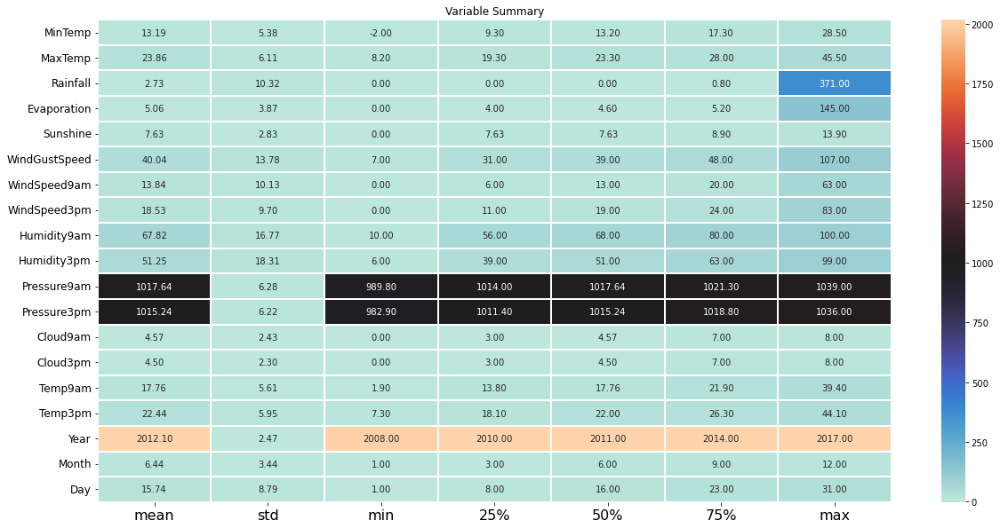

In [31]:
#Heatmap of the Descibe function

plt.figure(figsize=(20,10))
sns.heatmap(round(df.describe()[1:].transpose(),2),linewidth=2,annot=True,fmt='.2f',cmap='icefire')
plt.xticks(fontsize=16)
plt.yticks(fontsize=12)
plt.title('Variable Summary')
plt.show()

* we have Outliers in the dataset.

## 3- Data Visualization

### 3.1 Univariate Analysis

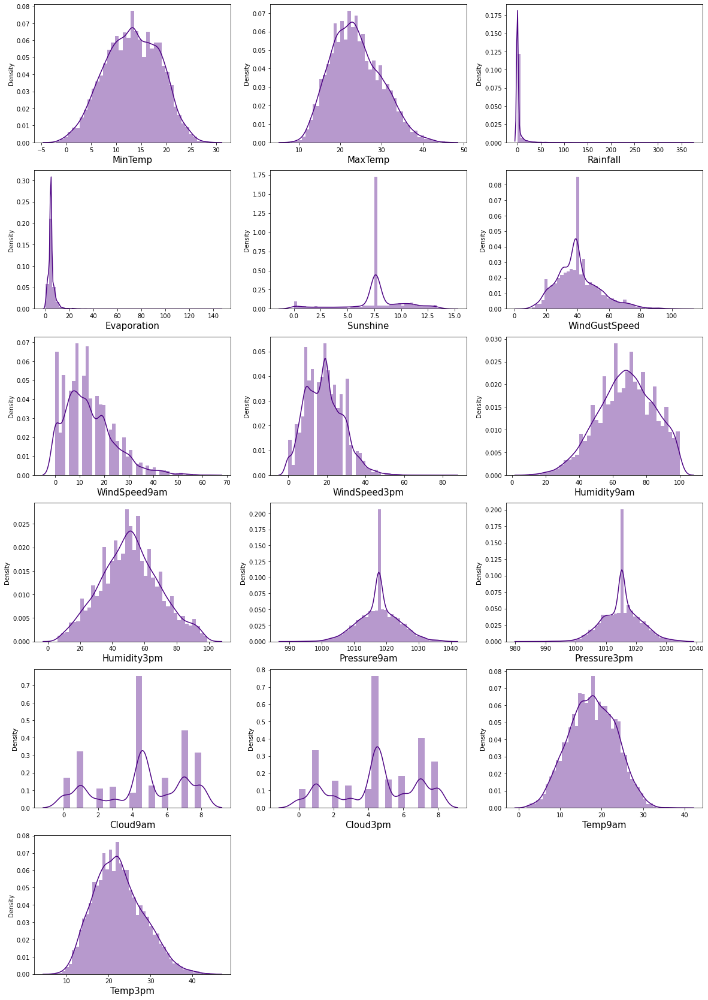

In [48]:
#The distribution of data for numerical columns?

plt.figure(figsize=(20,40), facecolor='white')
plotnumber = 1

for i in df[num_cols]:
    if plotnumber<=24 :
        ax = plt.subplot(8,3,plotnumber)
        sns.distplot(df[i],color='indigo')
        plt.xlabel(i,fontsize=15)
       
    plotnumber+=1
plt.show()

* Most of the columns are normally distributed except for Rainfall, Evaporation and Windspeed9am which are right skewed.


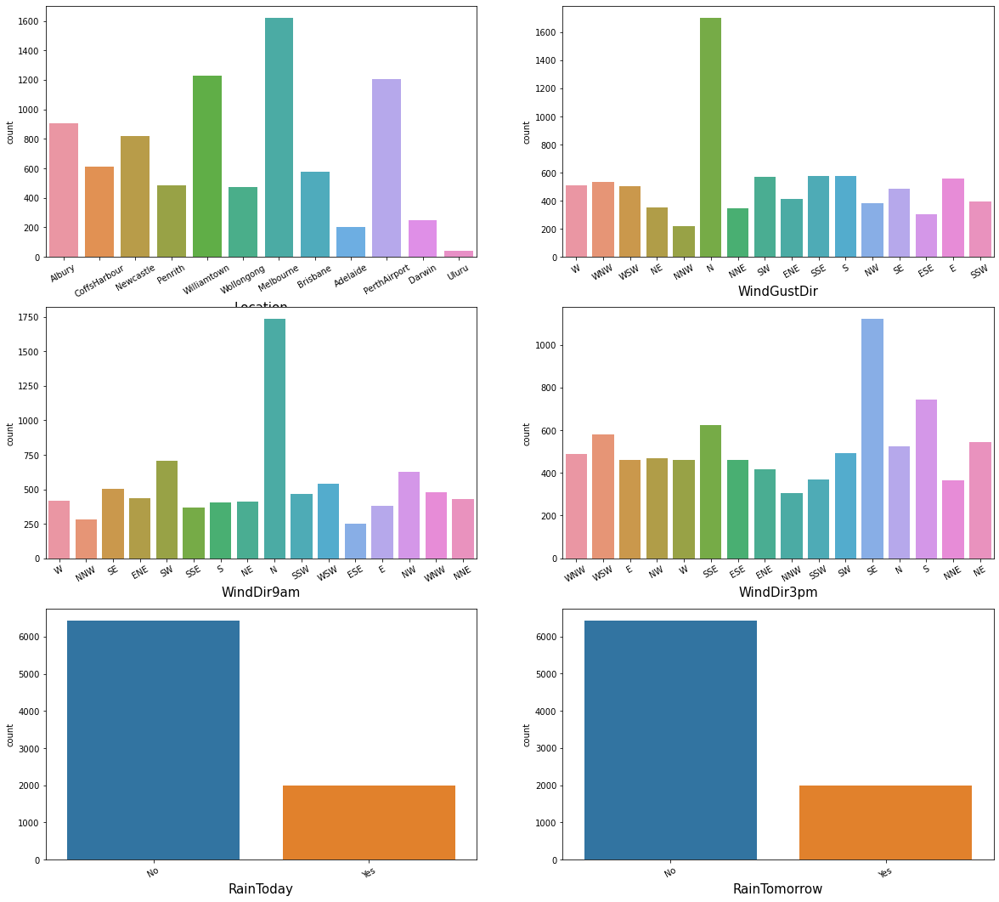

In [53]:
#the count of data for Categorical columns?

plt.figure(figsize=(20,25), facecolor='white')
plotnumber = 1

for i in df[cat_cols]:
    if plotnumber<=24 :
        ax = plt.subplot(4,2,plotnumber)
        sns.countplot(df[i])
        plt.xlabel(i,fontsize=15)
        plt.xticks(rotation=30)
       
    plotnumber+=1
plt.show()

* Location Melbourne has the most data and Uluru has the least data in my dataset.
* The strongest wind direction or(Wind gust speed) in a day ranges variedly and most of the data says North.
* Morning Wind direction(9.00 am) also shows North as the most in the dataset.
* Evening wind direction (3.00 pm) shows South east as the most in the dataset.
* Most of the time there is NO rain today and No Rain predicted for tomorrow.

### 3.2 Bivariate Analysis

In [62]:
#Lets plot a stacked plot of cat cols with target

def stacked_plot(df, group, target):
    fig, ax = plt.subplots(figsize = (8,5))
    temp_df = (df.groupby([group, target]).size()/df.groupby(group)[target].count()).reset_index().pivot(columns=target, index=group, values=0)
    temp_df.plot(kind='bar', stacked=True, ax = ax, color = ["blue", "red"])
    ax.xaxis.set_tick_params(rotation=30)
    ax.set_xlabel(group)
    ax.set_ylabel('Churn Percentage')

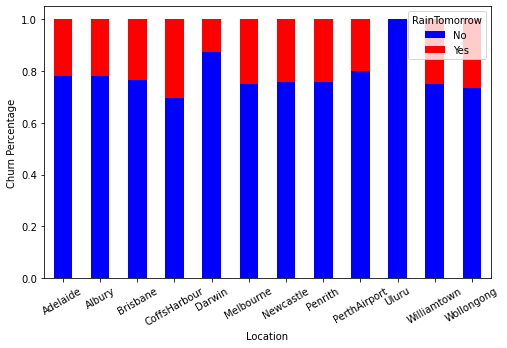

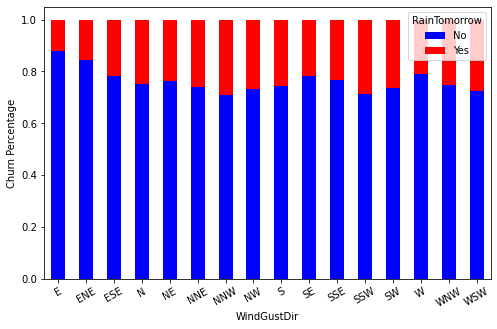

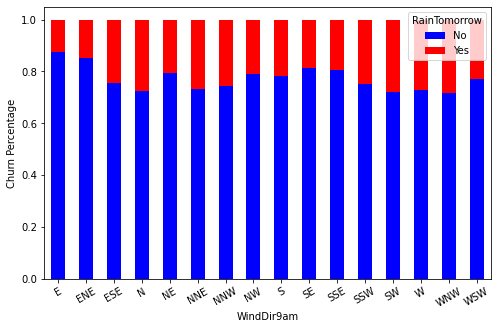

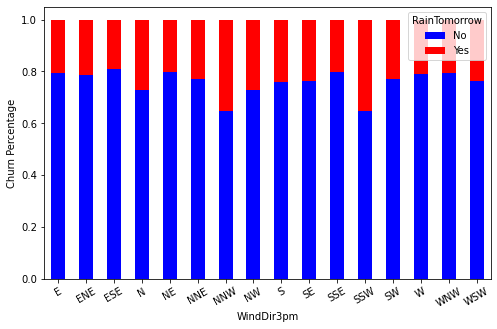

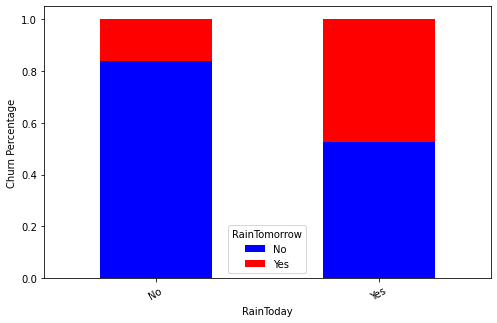

In [63]:
#lets check for gender, SeniorCitizen,Partner and Dependents

stacked_plot(df, "Location", "RainTomorrow")
stacked_plot(df, "WindGustDir", "RainTomorrow")
stacked_plot(df, "WindDir9am", "RainTomorrow")
stacked_plot(df, "WindDir3pm", "RainTomorrow")
stacked_plot(df, "RainToday", "RainTomorrow")

**Observations:**
    
* The rate of Rainfall predicted for tomorrow is more for CoffsHarbour and zero for Uluru.
* The rainfal rate is the most when the WindGustdirection is NNW and SSW.
* The windDir9am doesnt have a specific pattern but WindDir3pm suggest that rainfall is predicted to happen when it NNW and SSW.
* We can see that Raintoday and Raintomorrow are correlated highly.

In [67]:
num_cols

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm']

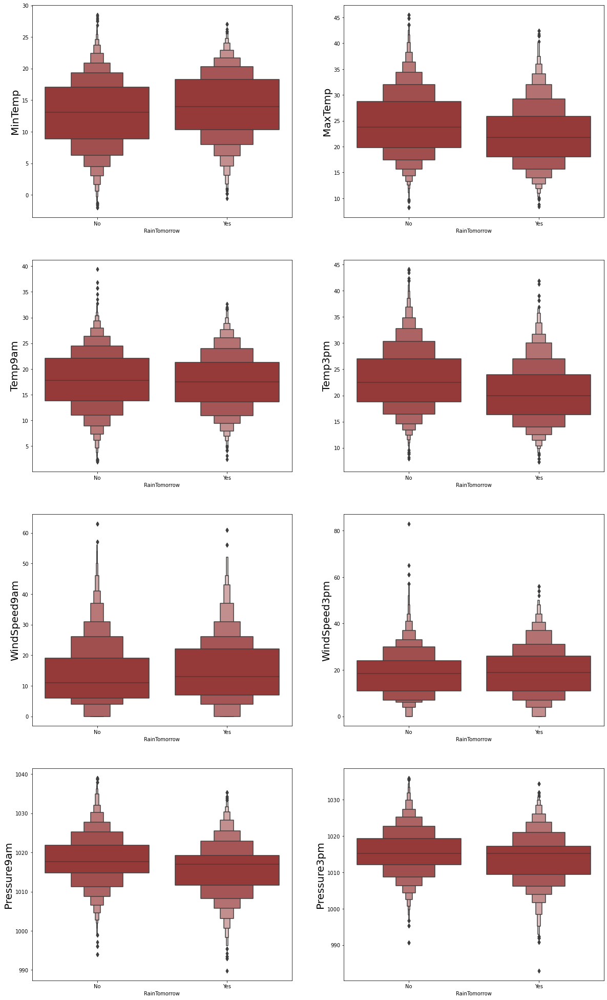

In [70]:
#the relation between numerical columns and the Target Variable?(Boxen plot)
#lets split num_cols
num_cols1=['MinTemp','MaxTemp','Temp9am','Temp3pm','WindSpeed9am','WindSpeed3pm','Pressure9am','Pressure3pm']
num_cols2=['Rainfall','Evaporation','Sunshine','WindGustSpeed','Humidity9am','Humidity3pm','Cloud9am','Cloud3pm']

plt.figure(figsize=(20,35), facecolor='white')
plotnumber = 1

for i in df[num_cols1]:
    if plotnumber<=24 :
        ax = plt.subplot(4,2,plotnumber)
        sns.boxenplot(x=df.RainTomorrow,y=df[i],color='brown')
        plt.ylabel(i,fontsize=20)
       
    plotnumber+=1
plt.show()

**Observations:**
    
* We can see more "No" than "Yes".
* When the MinTemp is between 12 to 17 and maxTemp between 17 to 27 chances of Rainfall on the next day is more.
* Morning Temp doesnt have any specific pattern but evening Temperature shows rainfall chance is more when temp is between 17 to 25 degree celsius
* Windspeed and pressure doesnt have a specific pattern.

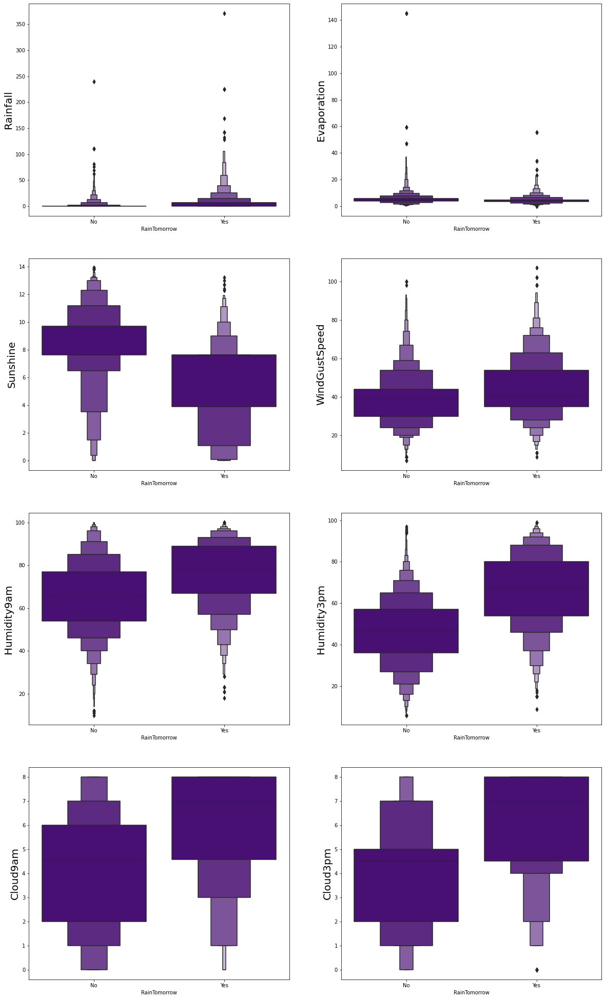

In [73]:
plt.figure(figsize=(20,35), facecolor='white')
plotnumber = 1

for i in df[num_cols2]:
    if plotnumber<=24 :
        ax = plt.subplot(4,2,plotnumber)
        sns.boxenplot(x=df.RainTomorrow,y=df[i],color='indigo')
        plt.ylabel(i,fontsize=20)
       
    plotnumber+=1
plt.show()

**Observations:**
    
* Rainfall and RainTomorrow have high correlation.
* Low Sunshine means More chance of RainTomorrow.
* WindGustspeed and RainTomorrow are positively correlated.
* When Humity is more chance of rainfall is higher.
* When cloud is more chance of rainfall is higher.

<AxesSubplot:xlabel='Sunshine', ylabel='Rainfall'>

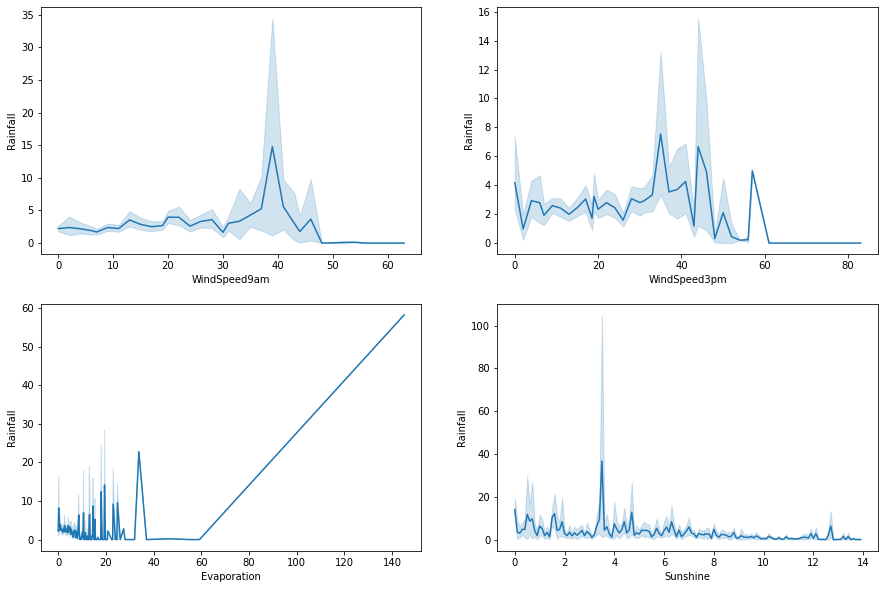

In [80]:
#lets check the plot between variables and our second target Rainfall

fig,axes=plt.subplots(2,2,figsize=(15,10))

#checking the relation between WindSpeed9am and Rainfall
sns.lineplot(x='WindSpeed9am',y='Rainfall',ax=axes[0,0],palette="OrRd",data=df)

#checking the relation between WindSpeed3pm and Rainfall
sns.lineplot(x='WindSpeed3pm',y='Rainfall',ax=axes[0,1],palette="OrRd",data=df)
#checking the relation between Evaporation and Rainfall
sns.lineplot(x='Evaporation',y='Rainfall',ax=axes[1,0],palette="OrRd",data=df)

#checking the relation between Sunshine and Rainfall
sns.lineplot(x='Sunshine',y='Rainfall',ax=axes[1,1],palette="OrRd",data=df)

* In the morning, at Windspeed between 30 to 40 km/h the rainfall is more.
* In the evening, at Windspeed and rainfall pattern varies.
* We can see that Evaporation and rainfall is correlated highly.
* Lesser sunshine more rainfall.

<AxesSubplot:xlabel='Humidity3pm', ylabel='Rainfall'>

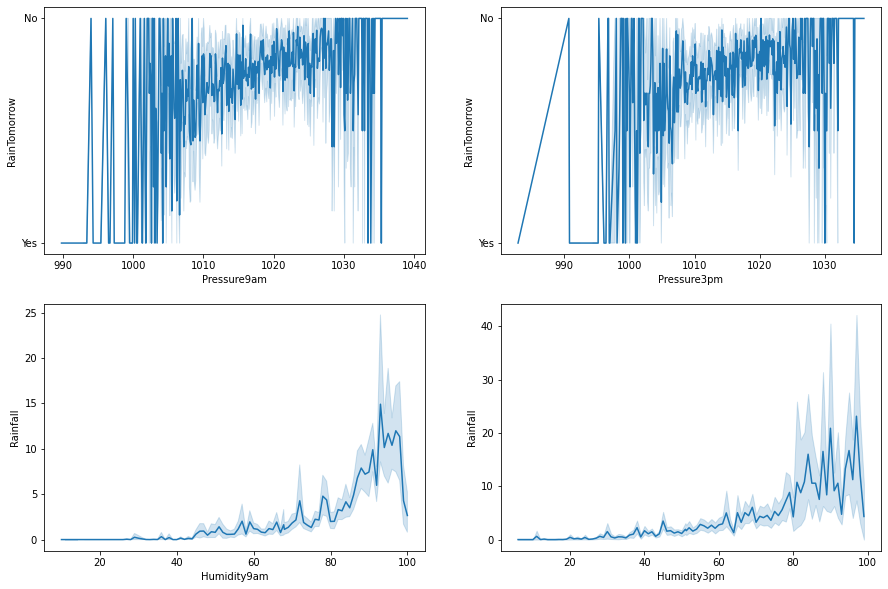

In [81]:
fig,axes=plt.subplots(2,2,figsize=(15,10))

#checking the relation between Humidity9am and RainTomorrow
sns.lineplot(x='Pressure9am',y='RainTomorrow',ax=axes[0,0],palette="OrRd",data=df)

#checking the relation between Humidity3pm and RainTomorrow
sns.lineplot(x='Pressure3pm',y='RainTomorrow',ax=axes[0,1],palette="OrRd",data=df)

#checking the relation between Humidity9am and Rainfall
sns.lineplot(x='Humidity9am',y='Rainfall',ax=axes[1,0],palette="OrRd",data=df)

#checking the relation between Humidity3pm and Rainfall
sns.lineplot(x='Humidity3pm',y='Rainfall',ax=axes[1,1],palette="OrRd",data=df)

<AxesSubplot:xlabel='Year', ylabel='Rainfall'>

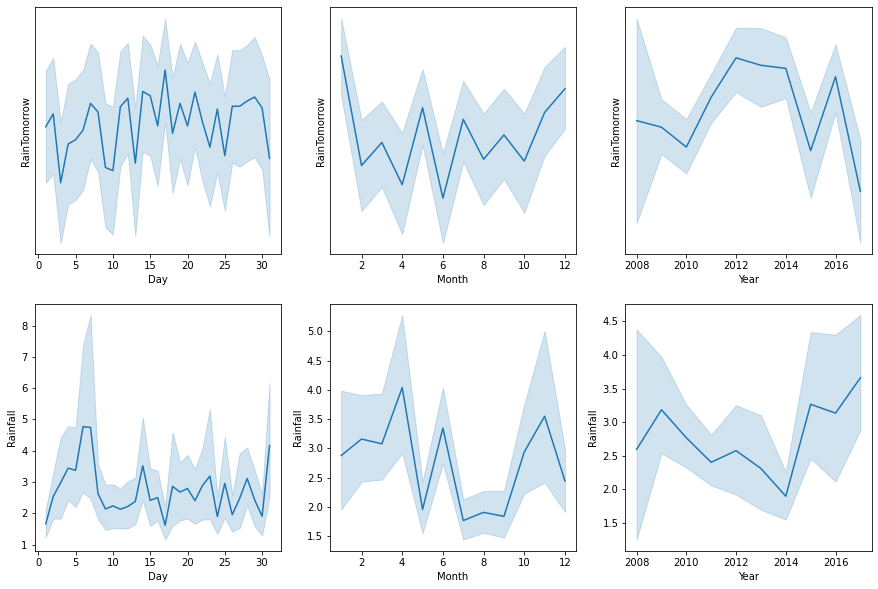

In [82]:
#lets check Day, month and Year with our targets.

fig,axes=plt.subplots(2,3,figsize=(15,10))

#checking the relation between Day and RainTomorrow
sns.lineplot(x='Day',y='RainTomorrow',ax=axes[0,0],data=df)

#checking the relation between Month and RainTomorrow
sns.lineplot(x='Month',y='RainTomorrow',ax=axes[0,1],data=df)

#checking the relation between Year and RainTomorrow
sns.lineplot(x='Year',y='RainTomorrow',ax=axes[0,2],data=df)

#checking the relation between Day and Rainfall
sns.lineplot(x='Day',y='Rainfall',ax=axes[1,0],palette=,data=df)

#checking the relation between Month and Rainfall
sns.lineplot(x='Month',y='Rainfall',ax=axes[1,1],data=df)

#checking the relation between Year and Rainfall
sns.lineplot(x='Year',y='Rainfall',ax=axes[1,2],data=df)

* There is no specific pattern between Raintomorrow and day, month and year.
* Although April, June and November has the highest Rainfall.

### 3.3 Multivariate Analysis

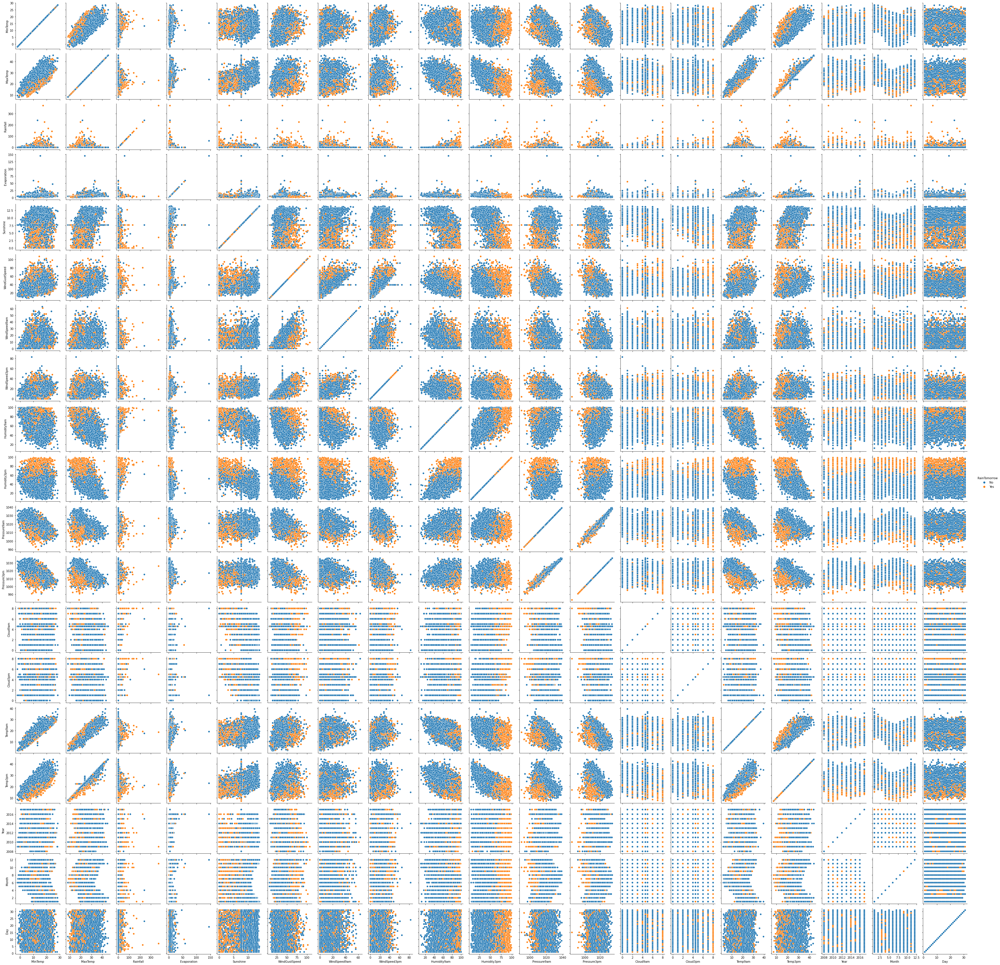

In [83]:
#the Comparison between variables

g = sns.PairGrid(df , hue = 'RainTomorrow')
g = g.map(sns.scatterplot)
g.add_legend()

* We can see some linear relation between target and variables.
* Multicollinearity is present in the dataset.

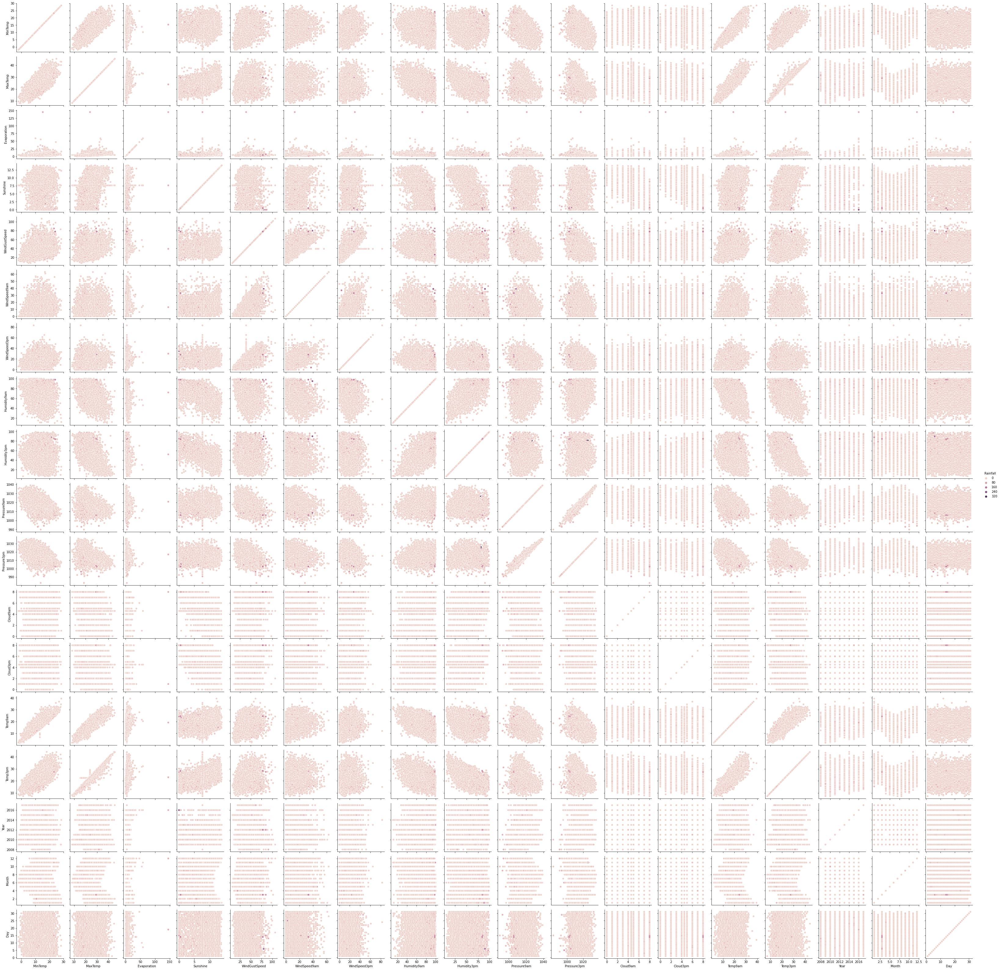

In [84]:
g = sns.PairGrid(df , hue = 'Rainfall')
g = g.map(sns.scatterplot)
g.add_legend()

Only certain times, we can see more rainfall.

# Prediction for RainTomorrow

## 4- Data Cleaning

### 4.1 Outliers

In [86]:
num_cols=[]
for i in df.dtypes.index:
    if df.dtypes[i]!='object':
        num_cols.append(i)
print(num_cols)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Year', 'Month', 'Day']


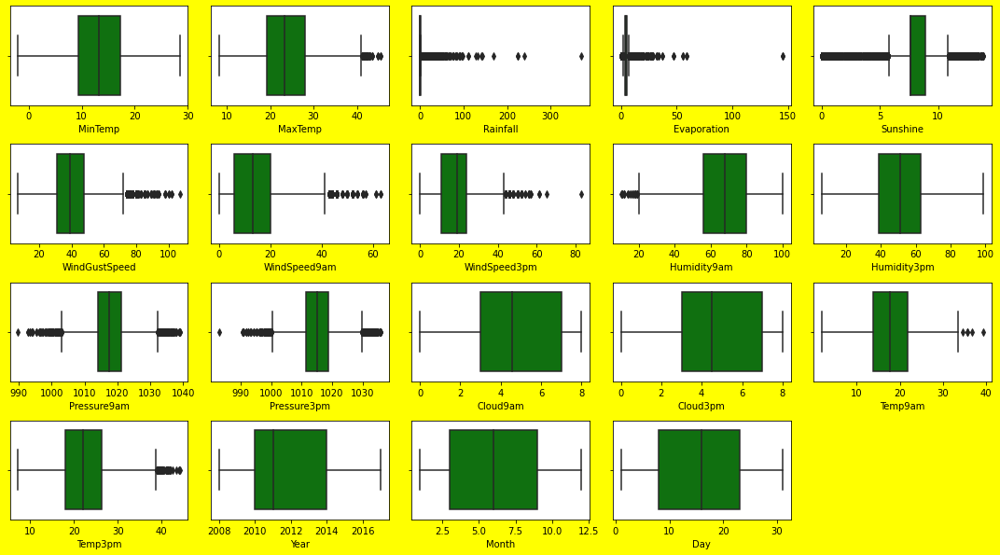

In [90]:
plt.figure(figsize=(15,10),facecolor='yellow')
graph=1 

for column in num_cols:

    plt.subplot(5,5,graph)

    sns.boxplot(df[column],color='green',orient='h')

    plt.xlabel(column,fontsize=10)

    graph+=1

    plt.tight_layout()

In [91]:
out_cols = df[['MaxTemp','Rainfall','Evaporation','Sunshine','WindGustSpeed','WindSpeed9am','WindSpeed3pm',
              'Humidity9am','Pressure9am','Pressure3pm','Temp9am','Temp3pm']]
from scipy.stats import zscore

z=np.abs(zscore(out_cols))
df_new=df[(z<3).all(axis=1)]
df_new

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,Albury,13.4,22.900000,0.6,4.6,7.632205,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,No,No,2008,12,1
1,Albury,7.4,25.100000,0.0,4.6,7.632205,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,No,No,2008,12,2
2,Albury,12.9,25.700000,0.0,4.6,7.632205,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,No,No,2008,12,3
3,Albury,9.2,28.000000,0.0,4.6,7.632205,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,No,No,2008,12,4
4,Albury,17.5,32.300000,1.0,4.6,7.632205,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,No,No,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,Uluru,2.8,23.400000,0.0,4.6,7.632205,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,No,No,2017,6,21
8421,Uluru,3.6,25.300000,0.0,4.6,7.632205,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,No,No,2017,6,22
8422,Uluru,5.4,26.900000,0.0,4.6,7.632205,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,No,No,2017,6,23
8423,Uluru,7.8,27.000000,0.0,4.6,7.632205,SE,28.0,SSE,N,13.0,7.0,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,No,No,2017,6,24


In [92]:
print('old data shape:',df.shape)
print('new data shape:',df_new.shape)

old data shape: (8425, 25)
new data shape: (7987, 25)


In [93]:
#checking the loss percentage

loss_percentage=(((8425-7987)/8425)*100)
loss_percentage

5.198813056379822

since loss percentage is below 10% we will proceed with this.

### 4.2 Skewness

In [98]:
#checking the skewness

df_new.skew().sort_values()

Sunshine        -0.723970
Cloud9am        -0.356892
Cloud3pm        -0.266829
Humidity9am     -0.231656
MinTemp         -0.084549
Temp9am         -0.038035
Day              0.002731
Pressure9am      0.020735
Pressure3pm      0.044876
Month            0.054460
Humidity3pm      0.125150
WindSpeed3pm     0.300109
MaxTemp          0.314510
Temp3pm          0.334170
Year             0.430100
WindGustSpeed    0.539852
WindSpeed9am     0.713786
Evaporation      1.280696
Rainfall         3.519090
dtype: float64

We have skewness in Rainfall, Evaporation, Sunshine, WindGustSpeed, WindSpeed9am.

In [99]:
#Using Power transformer to remove skewness in TotalCharges

skew_cols=["Rainfall", "Evaporation", "Sunshine", "WindGustSpeed", "WindSpeed9am"]

from sklearn.preprocessing import PowerTransformer
scaler = PowerTransformer(method='yeo-johnson')
df_new[skew_cols] = scaler.fit_transform(df_new[skew_cols].values)

In [100]:
#Checking the skewness again

df_new.skew()

MinTemp         -0.084549
MaxTemp          0.314510
Rainfall         1.040980
Evaporation      0.061105
Sunshine        -0.066262
WindGustSpeed    0.004523
WindSpeed9am    -0.110908
WindSpeed3pm     0.300109
Humidity9am     -0.231656
Humidity3pm      0.125150
Pressure9am      0.020735
Pressure3pm      0.044876
Cloud9am        -0.356892
Cloud3pm        -0.266829
Temp9am         -0.038035
Temp3pm          0.334170
Year             0.430100
Month            0.054460
Day              0.002731
dtype: float64

We still have skewness in rainfall. let check nplog method

In [101]:
df_new["Rainfall"] = np.log1p(df_new["Rainfall"])

In [102]:
df_new.skew()

MinTemp         -0.084549
MaxTemp          0.314510
Rainfall         0.845049
Evaporation      0.061105
Sunshine        -0.066262
WindGustSpeed    0.004523
WindSpeed9am    -0.110908
WindSpeed3pm     0.300109
Humidity9am     -0.231656
Humidity3pm      0.125150
Pressure9am      0.020735
Pressure3pm      0.044876
Cloud9am        -0.356892
Cloud3pm        -0.266829
Temp9am         -0.038035
Temp3pm          0.334170
Year             0.430100
Month            0.054460
Day              0.002731
dtype: float64

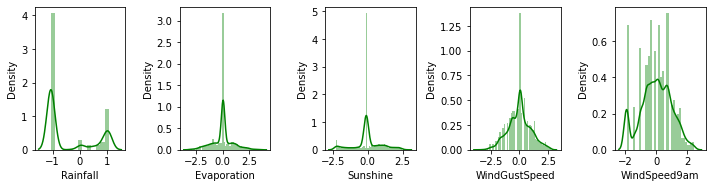

In [106]:
#plot for skewness check

plt.figure(figsize=(10,10))
graph=1 

for column in df_new[skew_cols]:

    plt.subplot(4,5,graph)

    sns.distplot(df_new[column],color='green')

    plt.xlabel(column,fontsize=10)

    graph+=1

    plt.tight_layout()

We have remov ed skewness at the maximum. 

### 4.3 Encoding

In [103]:
#Encoding the categorical columns:

from sklearn.preprocessing import OrdinalEncoder
enc=OrdinalEncoder()

for i in cat_cols:
    df_new[i]=enc.fit_transform(df_new[i].values.reshape(-1,1))

In [104]:
#new encoded df

df_new

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,1.0,13.4,22.900000,0.572706,0.033069,-0.097439,13.0,0.448790,13.0,14.0,0.785250,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,0.0,0.0,2008,12,1
1,1.0,7.4,25.100000,-1.061985,0.033069,-0.097439,14.0,0.448790,6.0,15.0,-0.982717,22.0,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,0.0,0.0,2008,12,2
2,1.0,12.9,25.700000,-1.061985,0.033069,-0.097439,15.0,0.593637,13.0,15.0,0.701237,26.0,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,0.0,0.0,2008,12,3
3,1.0,9.2,28.000000,-1.061985,0.033069,-0.097439,4.0,-1.250093,9.0,0.0,-0.062332,9.0,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,0.0,0.0,2008,12,4
4,1.0,17.5,32.300000,0.758751,0.033069,-0.097439,13.0,0.224831,1.0,7.0,-0.540338,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,0.0,0.0,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9.0,2.8,23.400000,-1.061985,0.033069,-0.097439,0.0,-0.591948,9.0,1.0,0.147286,11.0,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,0.0,0.0,2017,6,21
8421,9.0,3.6,25.300000,-1.061985,0.033069,-0.097439,6.0,-1.456067,9.0,3.0,0.147286,9.0,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,0.0,0.0,2017,6,22
8422,9.0,5.4,26.900000,-1.061985,0.033069,-0.097439,3.0,-0.087700,9.0,14.0,-0.289675,9.0,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,0.0,0.0,2017,6,23
8423,9.0,7.8,27.000000,-1.061985,0.033069,-0.097439,9.0,-0.863369,10.0,3.0,0.147286,7.0,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,0.0,0.0,2017,6,24


In [105]:
df_new.dtypes

Location         float64
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir      float64
WindGustSpeed    float64
WindDir9am       float64
WindDir3pm       float64
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday        float64
RainTomorrow     float64
Year               int64
Month              int64
Day                int64
dtype: object

### Our data is free from outliers, missing data imputed, skewness removed, and encoded. we are good to building the model.

### 4.4 Correlation

In [107]:
#lets check the correlation

df_new.corr()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
Location,1.000000,0.116694,0.063798,0.009639,0.110101,0.039174,-0.037707,0.256093,-0.041030,-0.031195,0.242006,0.231939,0.003725,0.059978,-0.024265,-0.012288,0.041859,0.027050,0.118100,0.060707,0.002934,0.009222,0.481143,-0.086011,-0.004978
MinTemp,0.116694,1.000000,0.718598,0.052980,0.392350,0.087866,-0.154935,0.249668,-0.045231,-0.154184,0.163324,0.185976,-0.126383,0.090208,-0.433113,-0.427936,0.089354,0.036649,0.888690,0.687570,0.061728,0.091021,0.040001,-0.247066,0.010924
MaxTemp,0.063798,0.718598,1.000000,-0.256299,0.488844,0.403083,-0.237955,0.151581,-0.217160,-0.190417,0.021424,0.093241,-0.382687,-0.409560,-0.333569,-0.414358,-0.252579,-0.248268,0.864864,0.974957,-0.219747,-0.149708,0.120204,-0.164351,0.017068
Rainfall,0.009639,0.052980,-0.256299,1.000000,-0.207855,-0.266296,0.134170,0.062402,0.155621,0.123405,0.011237,0.011732,0.412016,0.389712,-0.098198,-0.021809,0.302834,0.271987,-0.120315,-0.266349,0.878298,0.307088,0.009945,-0.005659,-0.018813
Evaporation,0.110101,0.392350,0.488844,-0.207855,1.000000,0.411843,-0.112642,0.196884,-0.094571,-0.039378,0.128495,0.121518,-0.352006,-0.241401,-0.266139,-0.281996,-0.134010,-0.163262,0.467829,0.473297,-0.172497,-0.093593,0.103405,-0.039374,0.013640
Sunshine,0.039174,0.087866,0.403083,-0.266296,0.411843,1.000000,-0.112272,0.032268,-0.082335,-0.073518,0.027076,0.062445,-0.392096,-0.439592,-0.012336,-0.074037,-0.543857,-0.555038,0.285620,0.418462,-0.223070,-0.315207,0.024638,0.001092,0.004631
WindGustDir,-0.037707,-0.154935,-0.237955,0.134170,-0.112642,-0.112272,1.000000,0.010467,0.405681,0.507292,0.080857,0.108357,0.031081,0.051061,-0.095047,-0.008263,0.123415,0.093527,-0.185080,-0.249791,0.121709,0.044378,-0.096042,0.038044,0.017003
WindGustSpeed,0.256093,0.249668,0.151581,0.062402,0.196884,0.032268,0.010467,1.000000,-0.061313,0.082607,0.547983,0.638803,-0.278466,-0.089346,-0.373415,-0.331119,0.009512,0.059854,0.220355,0.117052,0.076552,0.172511,-0.032144,0.046758,-0.005065
WindDir9am,-0.041030,-0.045231,-0.217160,0.155621,-0.094571,-0.082335,0.405681,-0.061313,1.000000,0.243622,0.141133,0.058887,0.009571,0.117910,-0.003943,0.081400,0.092396,0.062637,-0.101576,-0.224390,0.149239,0.027091,-0.034468,0.018344,-0.010014
WindDir3pm,-0.031195,-0.154184,-0.190417,0.123405,-0.039378,-0.073518,0.507292,0.082607,0.243622,1.000000,0.041537,0.079716,-0.007820,-0.009385,-0.129842,-0.037280,0.073742,0.054321,-0.172000,-0.202000,0.100983,0.003674,-0.010781,0.028629,-0.000714


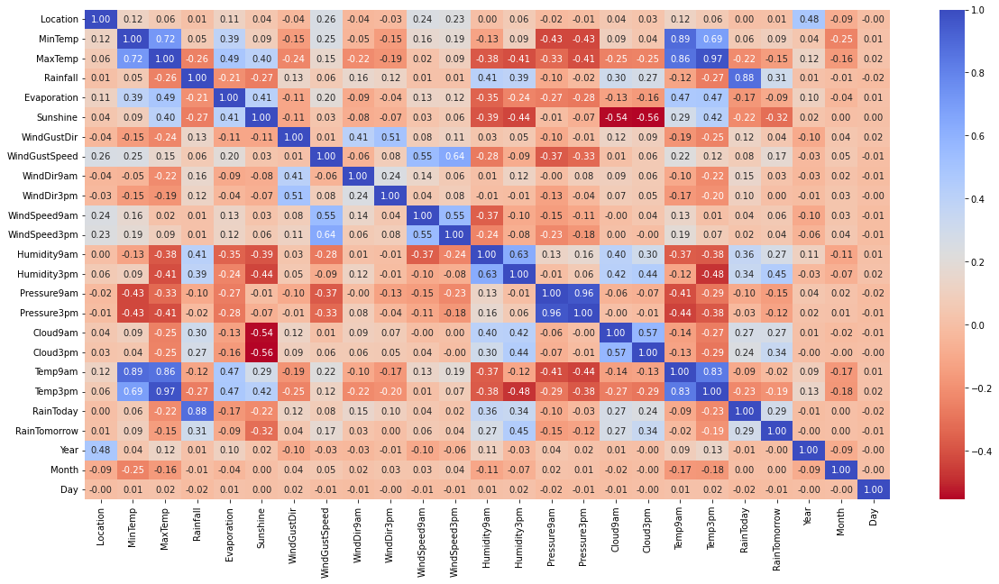

In [111]:
#Correlation Heat map

corr = df_new.corr()
plt.figure(figsize=(20,10), facecolor='white')
sns.heatmap(corr, annot=True,cmap='coolwarm_r',fmt='.2f')
plt.show()

**Observations:**

* We have multicollinearity in the dataset.
* Our target Rainfall is highly correlated with RainToday and followed by Humidity 9am and Humidity 3pm.
* Least correlation is between rainfall and year,month,windspeen3pm,windspeed 9am,location.
* Our target Raintomorrow is highly correlated with humidity 3pm  followed by cloud 3pm.
* Rain tomorrow is least correlated with year, month and wind direction at 3pm.

In [112]:
corr['RainTomorrow'].sort_values(ascending=False)

RainTomorrow     1.000000
Humidity3pm      0.445891
Cloud3pm         0.337922
Rainfall         0.307088
RainToday        0.294528
Humidity9am      0.269722
Cloud9am         0.269598
WindGustSpeed    0.172511
MinTemp          0.091021
WindSpeed9am     0.057012
WindGustDir      0.044378
WindSpeed3pm     0.042472
WindDir9am       0.027091
Location         0.009222
WindDir3pm       0.003674
Month            0.000135
Year            -0.003180
Day             -0.012493
Temp9am         -0.021459
Evaporation     -0.093593
Pressure3pm     -0.124953
MaxTemp         -0.149708
Pressure9am     -0.152692
Temp3pm         -0.191706
Sunshine        -0.315207
Name: RainTomorrow, dtype: float64

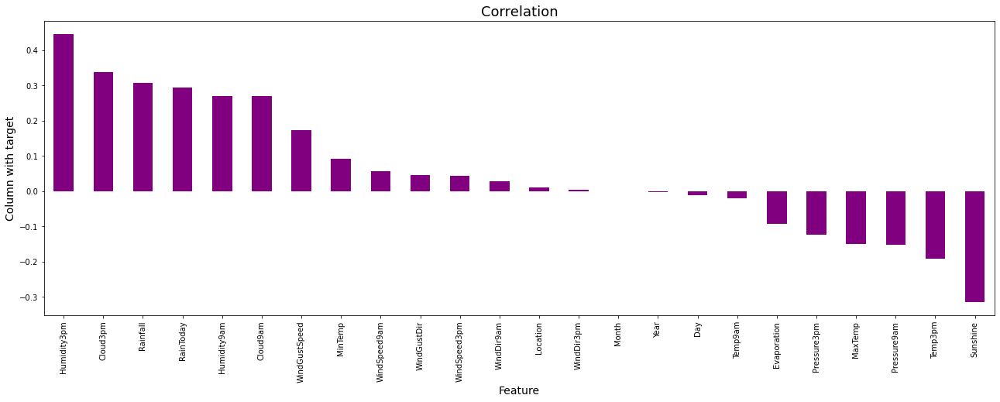

In [116]:
#Visualization of correlation:

plt.figure(figsize=(22,7))
df_new.corr()['RainTomorrow'].sort_values(ascending=False).drop(['RainTomorrow']).plot(kind='bar',color='purple')
plt.xlabel('Feature',fontsize=14)
plt.ylabel("Column with target",fontsize=14)
plt.title("Correlation",fontsize=18)
plt.show()

Our target Raintomorrow is highly correlated with humidity 3pm followed by cloud 3pm.
Rain tomorrow is least correlated with year, month and wind direction at 3pm.

### 4.5 Data splitting

In [117]:
#RainTomorrow as our target variable

x = df_new.drop("RainTomorrow",axis=1)
y = df_new["RainTomorrow"]

In [118]:
x

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Year,Month,Day
0,1.0,13.4,22.900000,0.572706,0.033069,-0.097439,13.0,0.448790,13.0,14.0,0.785250,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,0.0,2008,12,1
1,1.0,7.4,25.100000,-1.061985,0.033069,-0.097439,14.0,0.448790,6.0,15.0,-0.982717,22.0,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,0.0,2008,12,2
2,1.0,12.9,25.700000,-1.061985,0.033069,-0.097439,15.0,0.593637,13.0,15.0,0.701237,26.0,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,0.0,2008,12,3
3,1.0,9.2,28.000000,-1.061985,0.033069,-0.097439,4.0,-1.250093,9.0,0.0,-0.062332,9.0,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,0.0,2008,12,4
4,1.0,17.5,32.300000,0.758751,0.033069,-0.097439,13.0,0.224831,1.0,7.0,-0.540338,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,0.0,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9.0,2.8,23.400000,-1.061985,0.033069,-0.097439,0.0,-0.591948,9.0,1.0,0.147286,11.0,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,0.0,2017,6,21
8421,9.0,3.6,25.300000,-1.061985,0.033069,-0.097439,6.0,-1.456067,9.0,3.0,0.147286,9.0,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,0.0,2017,6,22
8422,9.0,5.4,26.900000,-1.061985,0.033069,-0.097439,3.0,-0.087700,9.0,14.0,-0.289675,9.0,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,0.0,2017,6,23
8423,9.0,7.8,27.000000,-1.061985,0.033069,-0.097439,9.0,-0.863369,10.0,3.0,0.147286,7.0,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,0.0,2017,6,24


In [119]:
y

0       0.0
1       0.0
2       0.0
3       0.0
4       0.0
       ... 
8420    0.0
8421    0.0
8422    0.0
8423    0.0
8424    0.0
Name: RainTomorrow, Length: 7987, dtype: float64

In [120]:
x.shape

(7987, 24)

In [121]:
y.shape

(7987,)

### 4.6 Standardization

In [124]:
#using Standard scaler to normalize the data

from sklearn.preprocessing import StandardScaler

ssc=StandardScaler()

x= pd.DataFrame(ssc.fit_transform(x), columns=x.columns)

In [125]:
x.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Year,Month,Day
0,-1.508427,0.056444,-0.145732,1.142269,0.033069,-0.097439,1.229267,0.448790,1.250245,1.400214,0.785250,0.638072,0.184123,-1.624174,-1.687142,-1.398115,1.425345,0.013138,-0.138099,-0.098593,-0.542476,-1.661315,1.634113,-1.671657
1,-1.508427,-1.058476,0.220676,-0.690128,0.033069,-0.097439,1.441960,0.448790,-0.277857,1.626597,-0.982717,0.421555,-1.455097,-1.457752,-1.202435,-1.279988,0.011773,0.013138,-0.084254,0.329747,-0.542476,-1.661315,1.634113,-1.557976
2,-1.508427,-0.036466,0.320605,-0.690128,0.033069,-0.097439,1.654654,0.593637,1.250245,1.626597,0.701237,0.854590,-1.819368,-1.180382,-1.703856,-1.128109,0.011773,-1.076661,0.597788,0.141277,-0.542476,-1.661315,1.634113,-1.444296
3,-1.508427,-0.724000,0.703668,-0.690128,0.033069,-0.097439,-0.684977,-1.250093,0.377044,-1.769138,-0.062332,-0.985811,-1.394385,-1.957019,-0.032451,-0.436219,0.011773,0.013138,0.077282,0.706687,-0.542476,-1.661315,1.634113,-1.330616
4,-1.508427,0.818306,1.419829,1.350816,0.033069,-0.097439,1.229267,0.224831,-1.369358,-0.184462,-0.540338,0.205037,0.851954,-1.013959,-1.169007,-1.583744,1.013630,1.535531,0.023437,1.254963,-0.542476,-1.661315,1.634113,-1.216936


Our data is scaled

### 4.7 Multicollinearity

In [126]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

def vif_calc():
    vif=pd.DataFrame()
    vif["VIF Factor"]=[variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
    vif["features"]=x.columns
    print(vif)

In [127]:
vif_calc()

    VIF Factor       features
0     1.588024       Location
1     8.845417        MinTemp
2    26.405469        MaxTemp
3     4.784362       Rainfall
4     1.619416    Evaporation
5     2.069709       Sunshine
6     1.613646    WindGustDir
7     2.300975  WindGustSpeed
8     1.363279     WindDir9am
9     1.490041     WindDir3pm
10    1.992282   WindSpeed9am
11    2.006549   WindSpeed3pm
12    4.016128    Humidity9am
13    5.374230    Humidity3pm
14   19.918600    Pressure9am
15   19.034380    Pressure3pm
16    1.938591       Cloud9am
17    1.825380       Cloud3pm
18   17.554930        Temp9am
19   33.263276        Temp3pm
20    4.427771      RainToday
21    1.525586           Year
22    1.154501          Month
23    1.004338            Day


We can see that we have high multicolinearity in: MaxTemp, Pressure9am, Pressure3pm, Temp9am, Temp3pm.

In [130]:
# Dropping Temp3pm column

x.drop("Temp3pm",axis=1,inplace=True)

# Dropping Temp9am column

x.drop("Temp9am",axis=1,inplace=True)

In [131]:
#lets check the vif factor again

vif_calc()

    VIF Factor       features
0     1.584947       Location
1     4.768375        MinTemp
2     5.775129        MaxTemp
3     4.783372       Rainfall
4     1.614311    Evaporation
5     2.060036       Sunshine
6     1.608805    WindGustDir
7     2.249186  WindGustSpeed
8     1.362302     WindDir9am
9     1.487800     WindDir3pm
10    1.971964   WindSpeed9am
11    1.959703   WindSpeed3pm
12    2.535162    Humidity9am
13    2.886047    Humidity3pm
14   19.293618    Pressure9am
15   18.521687    Pressure3pm
16    1.916876       Cloud9am
17    1.811731       Cloud3pm
18    4.426888      RainToday
19    1.500607           Year
20    1.125644          Month
21    1.003658            Day


In [132]:
# Dropping Pressure9am column
x.drop("Pressure9am",axis=1,inplace=True)

In [133]:
vif_calc()

    VIF Factor       features
0     1.584828       Location
1     4.554851        MinTemp
2     5.514706        MaxTemp
3     4.776347       Rainfall
4     1.598459    Evaporation
5     2.052843       Sunshine
6     1.594644    WindGustDir
7     2.232015  WindGustSpeed
8     1.340393     WindDir9am
9     1.420168     WindDir3pm
10    1.967217   WindSpeed9am
11    1.944104   WindSpeed3pm
12    2.533414    Humidity9am
13    2.886047    Humidity3pm
14    1.440931    Pressure3pm
15    1.916068       Cloud9am
16    1.810774       Cloud3pm
17    4.424431      RainToday
18    1.499437           Year
19    1.125161          Month
20    1.003036            Day


Multicollinearity is removed completely

### 4.8 SMOTE Technique

In [134]:
#Importing SMOTE and using it to balance

from imblearn.over_sampling import SMOTE

smt = SMOTE()
x,y = smt.fit_resample(x,y)

0.0    6165
1.0    6165
Name: RainTomorrow, dtype: int64


<AxesSubplot:xlabel='RainTomorrow', ylabel='count'>

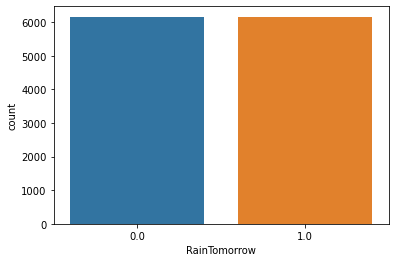

In [135]:
#Checking the count of Raintomorrow

print(y.value_counts())
sns.countplot(y)

Oversampling has been fixed

## 5- Building the model

In [136]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, roc_curve, roc_auc_score, accuracy_score
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import make_scorer, recall_score, confusion_matrix,precision_score, f1_score, accuracy_score, classification_report

### 5.1 Logistic Regression

In [137]:
#Finding the Best Random State

Accu=0
RS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =i)
    lr=LogisticRegression()
    lr.fit(x_train, y_train)
    pred = lr.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>Accu:
        Accu=acc
        RS=i
print("Best accuracy is ",Accu," on Random_state ",RS)

Best accuracy is  0.7931873479318735  on Random_state  95


In [138]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =RS)

lr=LogisticRegression()

lr.fit(x_train,y_train)
lr.score(x_train,y_train)
pred_lr=lr.predict(x_test)
print('Accuracy score of Logistic Regression is:')
print(accuracy_score(y_test,pred_lr))
print(confusion_matrix(y_test,pred_lr))
print(classification_report(y_test,pred_lr))

Accuracy score of Logistic Regression is:
0.7931873479318735
[[1480  382]
 [ 383 1454]]
              precision    recall  f1-score   support

         0.0       0.79      0.79      0.79      1862
         1.0       0.79      0.79      0.79      1837

    accuracy                           0.79      3699
   macro avg       0.79      0.79      0.79      3699
weighted avg       0.79      0.79      0.79      3699



In [143]:
#HyperParameter Tuning of LR

x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=RS)

lr_grid_param={'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
               'penalty':['none', 'elasticnet', 'l1', 'l2'],
               'C':[100, 10, 1.0, 0.1, 0.01],'multi_class':['auto', 'ovr', 'multinomial']}

gd_sr=GridSearchCV(estimator=lr,param_grid=lr_grid_param,cv=5,verbose=0)

gd_sr.fit(x,y)

best_parameters=gd_sr.best_params_
print(best_parameters)

print(gd_sr.best_score_)

{'C': 0.01, 'multi_class': 'auto', 'penalty': 'l1', 'solver': 'saga'}
0.7338199513381995


In [144]:
#Reinstating the tuned parameters:


lr=LogisticRegression(C=0.01,solver='saga',penalty='l1',multi_class='auto')

lr.fit(x_train,y_train)
lr.score(x_train,y_train)
predlr=lr.predict(x_test)
print('Accuracy score of Logistic Regression is:')
print(accuracy_score(y_test,predlr))
print(confusion_matrix(y_test,predlr))
print(classification_report(y_test,predlr))

Accuracy score of Logistic Regression is:
0.7910246012435793
[[1484  378]
 [ 395 1442]]
              precision    recall  f1-score   support

         0.0       0.79      0.80      0.79      1862
         1.0       0.79      0.78      0.79      1837

    accuracy                           0.79      3699
   macro avg       0.79      0.79      0.79      3699
weighted avg       0.79      0.79      0.79      3699



Our score is not improved

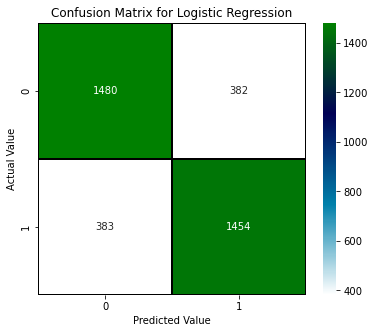

In [152]:
#Plotting the confusion Matrix,took predicted values from model without hyperparameter tuning

cm = confusion_matrix(y_test, pred_lr)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(6,5))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="ocean_r", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("Predicted Value")
plt.ylabel("Actual Value")
plt.title('Confusion Matrix for Logistic Regression')
plt.show()

### 5.2 DecisionTree Classifier

In [159]:
#Finding the best Randomstate:

Accu=0
RS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =i)
    dt = DecisionTreeClassifier()
    dt.fit(x_train, y_train)
    pred = dt.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>Accu:
        Accu=acc
        RS=i
print("Best accuracy is ",Accu," on Random_state ",RS)

Best accuracy is  0.8826709921600433  on Random_state  52


In [170]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =RS)

dtc=DecisionTreeClassifier()
dtc.fit(x_train,y_train)
dtc.score(x_train,y_train)
pred_dtc=dtc.predict(x_test)
print(accuracy_score(y_test,pred_dtc))
print(confusion_matrix(y_test,pred_dtc))
print(classification_report(y_test,pred_dtc))

0.8834820221681535
[[1636  221]
 [ 210 1632]]
              precision    recall  f1-score   support

         0.0       0.89      0.88      0.88      1857
         1.0       0.88      0.89      0.88      1842

    accuracy                           0.88      3699
   macro avg       0.88      0.88      0.88      3699
weighted avg       0.88      0.88      0.88      3699



In [155]:
#HyperParameter Tuning for DTC

x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=RS)

dtc= DecisionTreeClassifier()
dt_grid_param={'criterion':['gini','entropy'],
             'max_depth':np.arange(0,50),
             'max_features':["auto","sqrt","log2"],
             'max_leaf_nodes':[10,20,30],'min_samples_leaf': [5, 10, 20, 50, 100]}

gd_sr=GridSearchCV(estimator=dtc,param_grid=dt_grid_param,scoring='accuracy',cv=5,verbose=0)

gd_sr.fit(x,y)

best_parameters=gd_sr.best_params_
print(gd_sr)
print(gd_sr.best_score_)
print(gd_sr.best_estimator_)
print(gd_sr.best_params_)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49]),
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'max_leaf_nodes': [10, 20, 30],
                         'min_samples_leaf': [5, 10, 20, 50, 100]},
             scoring='accuracy')
0.7369018653690186
DecisionTreeClassifier(max_depth=27, max_features='log2', max_leaf_nodes=10,
                       min_samples_leaf=5)
{'criterion': 'gini', 'max_depth': 27, 'max_features': 'log2', 'max_leaf_nodes': 10, 'min_samples_leaf': 5}


In [156]:
#Reinstating the tuned parameters:

dtc_H=DecisionTreeClassifier(criterion='gini',max_depth=27,max_features='log2',
                           max_leaf_nodes=10, min_samples_leaf=5)
dtc_H.fit(x_train,y_train)
dtc_H.score(x_train,y_train)
preddtc=dtc_H.predict(x_test)
print(accuracy_score(y_test,preddtc))
print(confusion_matrix(y_test,preddtc))
print(classification_report(y_test,preddtc))

0.741551770748851
[[1256  601]
 [ 355 1487]]
              precision    recall  f1-score   support

         0.0       0.78      0.68      0.72      1857
         1.0       0.71      0.81      0.76      1842

    accuracy                           0.74      3699
   macro avg       0.75      0.74      0.74      3699
weighted avg       0.75      0.74      0.74      3699



Our score is reduced

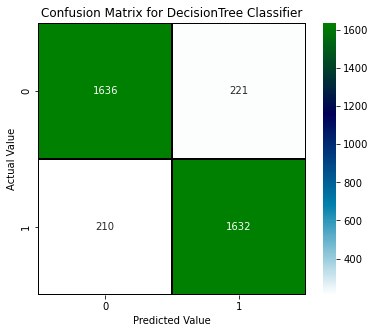

In [171]:
#Plotting the confusion Matrix

cm = confusion_matrix(y_test, pred_dtc)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(6,5))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="ocean_r", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("Predicted Value")
plt.ylabel("Actual Value")
plt.title('Confusion Matrix for DecisionTree Classifier')
plt.show()

### 5.3 Support Vector Classifier

In [172]:
#Finding the best random state:

Accu=0
RS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =i)
    sv=SVC()
    sv.fit(x_train, y_train)
    pred = sv.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>Accu:
        Accu=acc
        RS=i
print("Best accuracy is ",Accu," on Random_state ",RS)

Best accuracy is  0.8683427953500946  on Random_state  10


In [173]:
#Calling each kernel by defining svmkernel:

x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state = RS)

def svmkernel(ker):
    svc=SVC(kernel=ker)
    svc.fit(x_train,y_train)
    svc.score(x_train,y_train)
    predsvc=svc.predict(x_test)
    print(accuracy_score(y_test,predsvc))
    print(confusion_matrix(y_test,predsvc))
    print(classification_report(y_test,predsvc))

In [174]:
svmkernel('linear')

0.7831846444985131
[[1421  397]
 [ 405 1476]]
              precision    recall  f1-score   support

         0.0       0.78      0.78      0.78      1818
         1.0       0.79      0.78      0.79      1881

    accuracy                           0.78      3699
   macro avg       0.78      0.78      0.78      3699
weighted avg       0.78      0.78      0.78      3699



In [175]:
svmkernel('poly')

0.8488780751554474
[[1587  231]
 [ 328 1553]]
              precision    recall  f1-score   support

         0.0       0.83      0.87      0.85      1818
         1.0       0.87      0.83      0.85      1881

    accuracy                           0.85      3699
   macro avg       0.85      0.85      0.85      3699
weighted avg       0.85      0.85      0.85      3699



In [176]:
svmkernel('rbf')

0.8683427953500946
[[1546  272]
 [ 215 1666]]
              precision    recall  f1-score   support

         0.0       0.88      0.85      0.86      1818
         1.0       0.86      0.89      0.87      1881

    accuracy                           0.87      3699
   macro avg       0.87      0.87      0.87      3699
weighted avg       0.87      0.87      0.87      3699



rbf has the highest score.

In [177]:
#Hyperparameter tuning of SVC for better accuracy:

x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=RS)

sv=SVC()
sv_grid_param={'C': [0.1, 1, 10, 100, 1000],
              'gamma': [1, 0.1, 0.01, 0.001, 0.0001],
              'kernel': ['rbf']}

gd_sr=GridSearchCV(estimator=sv,param_grid=sv_grid_param,scoring='accuracy',cv=5)

gd_sr.fit(x,y)

best_parameters=gd_sr.best_params_
print(best_parameters)

print(gd_sr.best_score_)

{'C': 10, 'gamma': 1, 'kernel': 'rbf'}
0.9553122465531224


In [184]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=79)

svc_h=SVC(kernel='rbf',gamma=1,C=10)
svc_h.fit(x_train,y_train)
svc_h.score(x_train,y_train)
pred_svc=svc_h.predict(x_test)
print(accuracy_score(y_test,pred_svc))
print(confusion_matrix(y_test,pred_svc))
print(classification_report(y_test,pred_svc))

0.9402541227358746
[[1862   14]
 [ 207 1616]]
              precision    recall  f1-score   support

         0.0       0.90      0.99      0.94      1876
         1.0       0.99      0.89      0.94      1823

    accuracy                           0.94      3699
   macro avg       0.95      0.94      0.94      3699
weighted avg       0.95      0.94      0.94      3699



Our Score is improved from .86 to .94

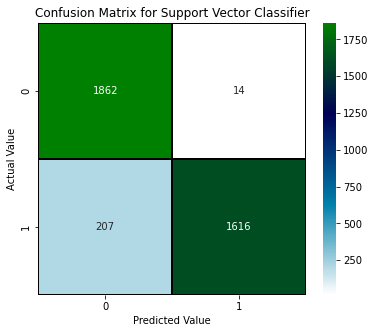

In [185]:
#Plotting the confusion Matrix

cm = confusion_matrix(y_test, pred_svc)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(6,5))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="ocean_r", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("Predicted Value")
plt.ylabel("Actual Value")
plt.title('Confusion Matrix for Support Vector Classifier')
plt.show()

#### Our false negative is more

### 5.4 Random Forest Classifier

In [186]:
#Finding the best random state

Accu=0
RS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =i)
    rf=RandomForestClassifier()
    rf.fit(x_train, y_train)
    pred = rf.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>Accu:
        Accu=acc
        RS=i
print("Best accuracy is ",Accu," on Random_state ",RS)

Best accuracy is  0.9389024060556908  on Random_state  95


In [187]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =RS)

rf=RandomForestClassifier()
rf.fit(x_train,y_train)
predrf=rf.predict(x_test)
print(accuracy_score(y_test,predrf))
print(confusion_matrix(y_test,predrf))
print(classification_report(y_test,predrf))

0.9343065693430657
[[1724  138]
 [ 105 1732]]
              precision    recall  f1-score   support

         0.0       0.94      0.93      0.93      1862
         1.0       0.93      0.94      0.93      1837

    accuracy                           0.93      3699
   macro avg       0.93      0.93      0.93      3699
weighted avg       0.93      0.93      0.93      3699



In [211]:
#Hyper Parameter Tuning for Random Forest

x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=RS)

rf=RandomForestClassifier()
rf_grid_param={"max_features": [1,3,10],
                "min_samples_split":[2,3,5,10],
                "min_samples_leaf":[1,3,10],
                "bootstrap":[False],
                "n_estimators":[200,300],
                "criterion":["gini",'entropy']}

gd_sr=GridSearchCV(estimator=rf,param_grid=rf_grid_param,scoring='accuracy',cv=5)

gd_sr.fit(x,y)

best_parameters=gd_sr.best_params_
print(best_parameters)

print(gd_sr.best_score_)

{'bootstrap': False, 'criterion': 'entropy', 'max_features': 1, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}
0.8138686131386861


In [212]:
#reinstating tuned parameters

x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =95)

rf_h=RandomForestClassifier(n_estimators=200,bootstrap=False,criterion='entropy',
                         max_features=1,min_samples_leaf=1,min_samples_split=2)
rf_h.fit(x_train,y_train)
rf_h.score(x_train,y_train)
predrf=rf_h.predict(x_test)
print(accuracy_score(y_test,predrf))
print(confusion_matrix(y_test,predrf))
print(classification_report(y_test,predrf))

0.9524195728575291
[[1767   95]
 [  81 1756]]
              precision    recall  f1-score   support

         0.0       0.96      0.95      0.95      1862
         1.0       0.95      0.96      0.95      1837

    accuracy                           0.95      3699
   macro avg       0.95      0.95      0.95      3699
weighted avg       0.95      0.95      0.95      3699



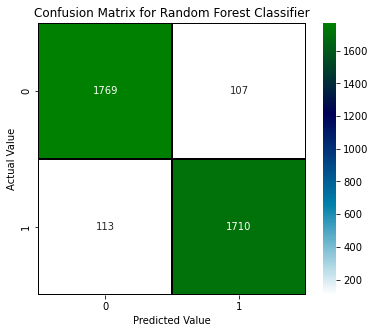

In [214]:
#Plotting the confusion Matrix

cm = confusion_matrix(y_test, predrf)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(6,5))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="ocean_r", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("Predicted Value")
plt.ylabel("Actual Value")
plt.title('Confusion Matrix for Random Forest Classifier')
plt.show()

### 4.5 KNN Classifier

In [194]:
#Finding the best random state:

Accu=0
RS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =i)
    knn=KNeighborsClassifier()
    knn.fit(x_train, y_train)
    pred = knn.predict(x_test)
    acc=accuracy_score(y_test, pred)
    if acc>Accu:
        Accu=acc
        RS=i
print("Best accuracy is ",Accu," on Random_state ",RS)

Best accuracy is  0.870235198702352  on Random_state  74


In [195]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =RS)

knn=KNeighborsClassifier()
knn.fit(x_train,y_train)
knn.score(x_train,y_train)
pred_knn=knn.predict(x_test)
print(accuracy_score(y_test,pred_knn))
print(confusion_matrix(y_test,pred_knn))
print(classification_report(y_test,pred_knn))

0.870235198702352
[[1449  405]
 [  75 1770]]
              precision    recall  f1-score   support

         0.0       0.95      0.78      0.86      1854
         1.0       0.81      0.96      0.88      1845

    accuracy                           0.87      3699
   macro avg       0.88      0.87      0.87      3699
weighted avg       0.88      0.87      0.87      3699



In [196]:
#HyperParameter Tuning of knn:

x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=RS)

knn=KNeighborsClassifier()
knn_grid_param={"n_neighbors": np.arange(1, 25, 2),
                "weights": ["uniform","distance"],
                'metric' : ['minkowski','euclidean','manhattan'],
                'algorithm':['auto','ball_tree','kd_tree','brute']}

gd_sr=GridSearchCV(estimator=knn,param_grid=knn_grid_param,scoring='accuracy',cv=5)

gd_sr.fit(x,y)

best_parameters=gd_sr.best_params_
print(best_parameters)

print(gd_sr.best_score_)

{'algorithm': 'auto', 'metric': 'minkowski', 'n_neighbors': 1, 'weights': 'uniform'}
0.7952960259529602


In [236]:
#Reinstating the tuned parameters
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =74)

knn_h=KNeighborsClassifier(n_neighbors=1,metric='minkowski',weights='uniform',algorithm='auto')
knn_h.fit(x_train,y_train)
knn_h.score(x_train,y_train)
predknn=knn_h.predict(x_test)
print(accuracy_score(y_test,predknn))
print(confusion_matrix(y_test,predknn))
print(classification_report(y_test,predknn))

0.9316031359826981
[[1637  217]
 [  36 1809]]
              precision    recall  f1-score   support

         0.0       0.98      0.88      0.93      1854
         1.0       0.89      0.98      0.93      1845

    accuracy                           0.93      3699
   macro avg       0.94      0.93      0.93      3699
weighted avg       0.94      0.93      0.93      3699



Our score has improved

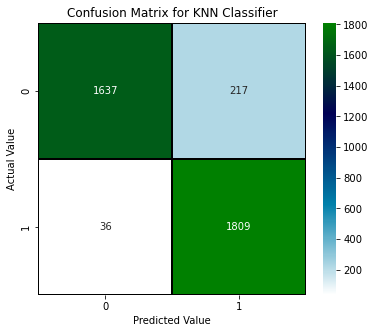

In [237]:
#Plotting the confusion Matrix

cm = confusion_matrix(y_test, predknn)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(6,5))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="ocean_r", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("Predicted Value")
plt.ylabel("Actual Value")
plt.title('Confusion Matrix for KNN Classifier')
plt.show()

### 4.6 Gradient Boosting classifier

In [228]:
from sklearn.ensemble import GradientBoostingClassifier

x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =None)

GBC=GradientBoostingClassifier()
GBC.fit(x_train,y_train)
predgb=GBC.predict(x_test)
print('Accuracy Score:',accuracy_score(y_test, predgb))
print('Confusion Matrix:',confusion_matrix(y_test, predgb))
print(classification_report(y_test,predgb))

Accuracy Score: 0.8613138686131386
Confusion Matrix: [[1582  263]
 [ 250 1604]]
              precision    recall  f1-score   support

         0.0       0.86      0.86      0.86      1845
         1.0       0.86      0.87      0.86      1854

    accuracy                           0.86      3699
   macro avg       0.86      0.86      0.86      3699
weighted avg       0.86      0.86      0.86      3699



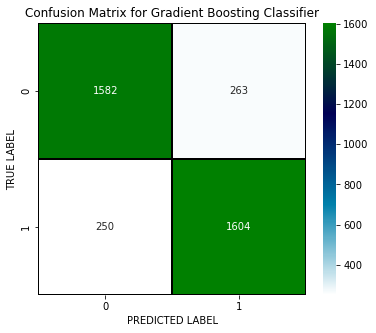

In [229]:
cm = confusion_matrix(y_test, predgb)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]


f, ax = plt.subplots(figsize =(6,5))
sns.heatmap(cm, annot = True, linewidths=0.2, linecolor="black", fmt = ".0f", ax=ax, cmap="ocean_r", xticklabels=x_axis_labels, yticklabels=y_axis_labels)
plt.xlabel("PREDICTED LABEL")
plt.ylabel("TRUE LABEL")
plt.title('Confusion Matrix for Gradient Boosting Classifier')
plt.show()

### 4.7 XGB Classifier

In [203]:
#Selecting the best random state to get maximum accuracy.
from xgboost import XGBClassifier

Accu=0
RS=0
for i in range(1,100):
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=i)
    XGB=XGBClassifier()
    XGB.fit(x_train,y_train)
    pred=XGB.predict(x_test)
    acc = accuracy_score(y_test, pred)
    if acc>Accu:
        Accu=acc
        RS=i
print("Best accuracy is ",Accu," on Random_state ",RS)

Best accuracy is  0.9394430927277643  on Random_state  83


In [238]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=.30, random_state =83)

# Checking accuracy for XGBClassifier
XGB=XGBClassifier(verbosity=0)
XGB.fit(x_train,y_train)

# Prediction
predxgb = XGB.predict(x_test)

print(accuracy_score(y_test, predxgb))
print(confusion_matrix(y_test, predxgb))
print(classification_report(y_test,predxgb))

0.9394430927277643
[[1775   98]
 [ 126 1700]]
              precision    recall  f1-score   support

         0.0       0.93      0.95      0.94      1873
         1.0       0.95      0.93      0.94      1826

    accuracy                           0.94      3699
   macro avg       0.94      0.94      0.94      3699
weighted avg       0.94      0.94      0.94      3699



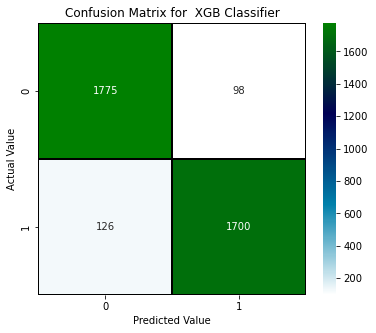

In [239]:
# Lets plot confusion matrix for  XGBClassifier
cm = confusion_matrix(y_test,predxgb)

x_axis_labels = ["0","1"]
y_axis_labels = ["0","1"]

f, ax = plt.subplots(figsize =(6,5))
sns.heatmap(cm, annot = True,linewidths=.2, linecolor="black", fmt = ".0f", ax=ax, cmap="ocean_r",xticklabels=x_axis_labels,yticklabels=y_axis_labels)

plt.xlabel("Predicted Value")
plt.ylabel("Actual Value")
plt.title('Confusion Matrix for  XGB Classifier')
plt.show()

## Cross Validation Score

In [240]:
score=cross_val_score(lr,x,y,cv=5)
score_a=score.mean()
print("Cross_Val_Score of LR:",score_a)

Cross_Val_Score of LR: 0.7338199513381995


In [241]:
score=cross_val_score(dtc,x,y,cv=5)
score_b=score.mean()
print("Cross_Val_Score of DTC:",score_b)

Cross_Val_Score of DTC: 0.7101378751013788


In [242]:
score=cross_val_score(svc_h,x,y,cv=5)
score_c=score.mean()
print("Cross_Val_Score of SVC:",score_c)

Cross_Val_Score of SVC: 0.9553122465531224


In [254]:
score=cross_val_score(rf_h,x,y,cv=5)
score_d=score.mean()
print("Cross_Val_Score of RF:",score_d)

Cross_Val_Score of RF: 0.8103000811030008


In [244]:
score=cross_val_score(knn_h,x,y,cv=5)
score_e=score.mean()
print("Cross_Val_Score of KNN:",score_e)

Cross_Val_Score of KNN: 0.7952960259529602


In [257]:
score=cross_val_score(GBC,x,y,cv=5)
score_f=score.mean()
print("Cross_Val_Score of Gradient Boosting:",score_f)

Cross_Val_Score of Gradient Boosting: 0.6636658556366586


In [258]:
score=cross_val_score(XGB,x,y,cv=5)
score_g=score.mean()
print("Cross_Val_Score of XGB Classifier:",score_g)

Cross_Val_Score of XGB Classifier: 0.6968369829683698


Text(0.5, 1.0, 'Cross Validation Scores')

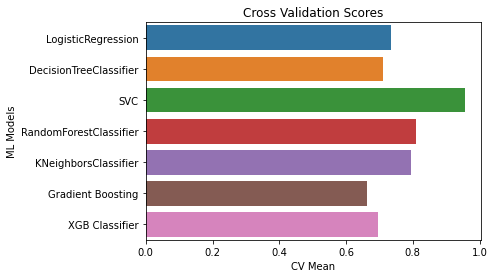

In [259]:
cv_result=[score_a,score_b,score_c,score_d,score_e,score_f,score_g]
cv_results = pd.DataFrame({"Cross Validation Means":cv_result, "ML Models":[ "LogisticRegression",
            "DecisionTreeClassifier", "SVC","RandomForestClassifier","KNeighborsClassifier",
            "Gradient Boosting","XGB Classifier"]})

g = sns.barplot("Cross Validation Means", "ML Models", data = cv_results)
g.set_xlabel("CV Mean")
g.set_title("Cross Validation Scores")

## We have CV score of SVC more

Text(0.5, 1.0, 'Accuracy scores of different Models')

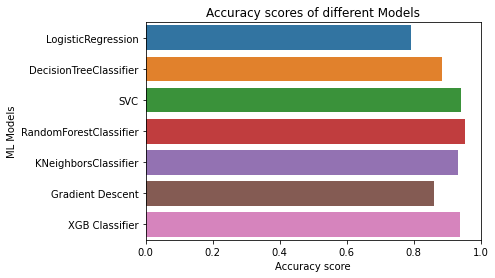

In [260]:
score_lr=0.7931873479318735
score_dtc=0.8834820221681535
score_svc=0.9402541227358746
score_rf=0.9524195728575291
score_knn=0.9316031359826981
score_gbc=0.8613138686131386
score_xgb=0.9394430927277643

acc_result=[score_lr,score_dtc,score_svc,score_rf,score_knn,score_gbc,score_xgb]
acc_results = pd.DataFrame({"Accuracy Scores":acc_result, "ML Models":[ "LogisticRegression",
            "DecisionTreeClassifier", "SVC","RandomForestClassifier","KNeighborsClassifier",
            "Gradient Descent","XGB Classifier"]})

g = sns.barplot("Accuracy Scores", "ML Models", data = acc_results)
g.set_xlabel("Accuracy score")
g.set_title("Accuracy scores of different Models")

## Considering the accuracy score, random forest is good.

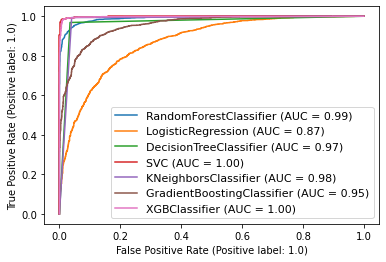

In [261]:
# Plotting AUC-ROC Curve for all the models used here 

from sklearn.metrics import plot_roc_curve 

disp = plot_roc_curve(rf_h,x_test,y_test)
plot_roc_curve(lr, x_test, y_test, ax=disp.ax_)    
plot_roc_curve(dtc,x_test, y_test, ax=disp.ax_)
plot_roc_curve(svc_h, x_test, y_test, ax=disp.ax_)
plot_roc_curve(knn_h, x_test, y_test, ax=disp.ax_)
plot_roc_curve(GBC, x_test, y_test, ax=disp.ax_)
plot_roc_curve(XGB, x_test, y_test, ax=disp.ax_)

plt.legend(prop={'size':11}, loc='lower right')
plt.show()

## We have XGB and SVC is the best in ROC curve, and CV score is high for SVC, i am taking SVC as the final model.

In [272]:
#final model

x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=85)

Final_Model=SVC(kernel='rbf',gamma=1,C=10,probability=True)
Final_Model.fit(x_train,y_train)
Final_Model.score(x_train,y_train)
predsvc=Final_Model.predict(x_test)
print(accuracy_score(y_test,predsvc))
print(confusion_matrix(y_test,predsvc))
print(classification_report(y_test,predsvc))

0.9445796161124629
[[1847    8]
 [ 197 1647]]
              precision    recall  f1-score   support

         0.0       0.90      1.00      0.95      1855
         1.0       1.00      0.89      0.94      1844

    accuracy                           0.94      3699
   macro avg       0.95      0.94      0.94      3699
weighted avg       0.95      0.94      0.94      3699



## AUC-ROC CURVE

In [273]:
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

y_pred_prob=Final_Model.predict_proba(x_test)[:,1]
y_pred_prob

array([1.00000000e+00, 3.84652457e-02, 7.80291826e-02, ...,
       8.75908171e-03, 8.78381416e-06, 8.70816687e-06])

In [274]:
fpr,tpr,thresholds=roc_curve(y_test,y_pred_prob)

In [275]:
fpr

array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
      

In [276]:
tpr

array([0.        , 0.13394794, 0.13611714, 0.14099783, 0.14208243,
       0.14262473, 0.14370933, 0.14642082, 0.14804772, 0.14967462,
       0.15075922, 0.15184382, 0.15401302, 0.15726681, 0.15835141,
       0.15943601, 0.16052061, 0.164859  , 0.1659436 , 0.1670282 ,
       0.1691974 , 0.170282  , 0.17245119, 0.17624729, 0.17733189,
       0.18438178, 0.18546638, 0.18655098, 0.18763557, 0.19305857,
       0.19414317, 0.19522777, 0.19631236, 0.19793926, 0.19902386,
       0.20010846, 0.20119306, 0.20173536, 0.20281996, 0.20390456,
       0.20715835, 0.22017354, 0.22776573, 0.23752711, 0.2483731 ,
       0.25542299, 0.26572668, 0.28796095, 0.31724512, 0.3291757 ,
       0.3373102 , 0.34707158, 0.35791757, 0.36442516, 0.36876356,
       0.37147505, 0.37255965, 0.37364425, 0.37635575, 0.37798265,
       0.37906725, 0.38503254, 0.38611714, 0.39587852, 0.39696312,
       0.40672451, 0.40780911, 0.4137744 , 0.4154013 , 0.4175705 ,
       0.4186551 , 0.42624729, 0.42733189, 0.43329718, 0.43438

In [277]:
thresholds

array([2.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
       1.00000000e+00, 1.00000000e+00, 1.00000000e+00, 1.00000000e+00,
      

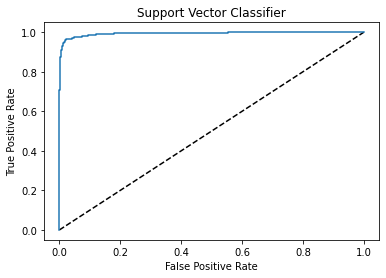

In [278]:
plt.plot([0,1],[0,1],'k--')
plt.plot(fpr,tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Support Vector Classifier')
plt.show()

In [279]:
auc_score=roc_auc_score(y_test,Final_Model.predict(x_test))
print((auc_score)*100)

94.44271798679772


## Saving the Final Model for future Predictions

In [280]:
import joblib
joblib.dump(Final_Model,'Weather_Prediction_SVC.pkl')

['Weather_Prediction_SVC.pkl']

Text(0.5, 0, 'Permutation Importance')

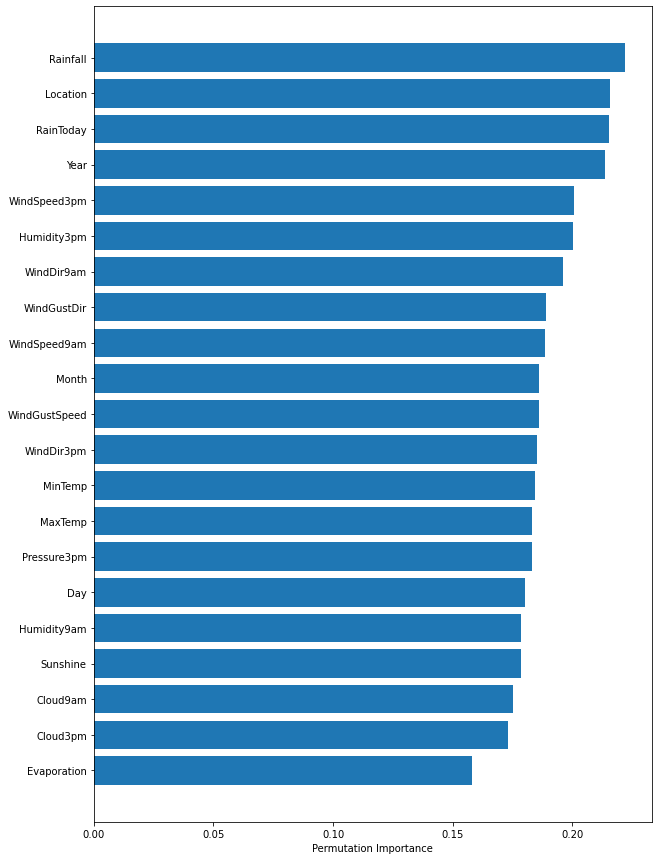

In [281]:
#To check feature Importance for SVC Final Model with kernel 'rbf'

from sklearn.inspection import permutation_importance
perm_importance = permutation_importance(Final_Model, x_test, y_test)

plt.figure(figsize=[10,15])
sorted_idx = perm_importance.importances_mean.argsort()
plt.barh(x.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.xlabel("Permutation Importance")


### According to permutation importance in our final model SVC,  features : Rainfall amount, Raintoday, Year and location are the most important features.

<AxesSubplot:>

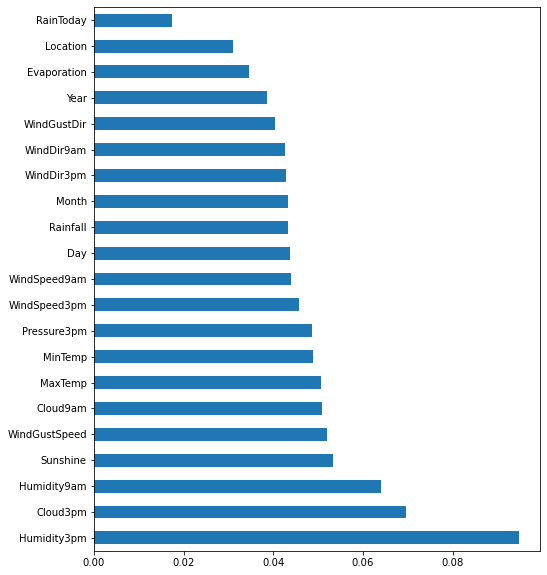

In [283]:
#Checking Feature Importance with Random Forest Model

feat_importances = pd.Series(rf_h.feature_importances_, index=x.columns)
feat_importances.nlargest(100).plot(kind='barh',figsize=(8,10))

### According to  random forest model, important features are Humidity3pm, cloud3pm, and humidity 9am 

## Checking Actual and Predicted

In [284]:
# Loading the saved model
model=joblib.load("Weather_Prediction_SVC.pkl")

#Prediction
prediction = model.predict(x_test)
prediction

array([1., 0., 0., ..., 0., 0., 0.])

In [285]:
#saving as dataframe

base = pd.DataFrame()
base["actual"] = y_test
base["predictions"] = prediction

#Adding another column of thier difference. 

base['difference']=base['actual']-base['predictions']

#If 0 then actual and predicted are same. else its different

print(base['difference'].value_counts())

 0.0    3494
 1.0     197
-1.0       8
Name: difference, dtype: int64


In [286]:
a=(205/3494)*100
a

5.8672009158557525

### We got only 5% error with our model. It is a Good score

# Prediction for Rainfall

In [32]:
df

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,Albury,13.4,22.900000,0.6,4.6,7.632205,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,No,No,2008,12,1
1,Albury,7.4,25.100000,0.0,4.6,7.632205,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,No,No,2008,12,2
2,Albury,12.9,25.700000,0.0,4.6,7.632205,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,No,No,2008,12,3
3,Albury,9.2,28.000000,0.0,4.6,7.632205,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,No,No,2008,12,4
4,Albury,17.5,32.300000,1.0,4.6,7.632205,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,No,No,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,Uluru,2.8,23.400000,0.0,4.6,7.632205,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,No,No,2017,6,21
8421,Uluru,3.6,25.300000,0.0,4.6,7.632205,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,No,No,2017,6,22
8422,Uluru,5.4,26.900000,0.0,4.6,7.632205,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,No,No,2017,6,23
8423,Uluru,7.8,27.000000,0.0,4.6,7.632205,SE,28.0,SSE,N,13.0,7.0,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,No,No,2017,6,24


In [33]:
df.columns

Index(['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow', 'Year', 'Month', 'Day'],
      dtype='object')

In [43]:
cat_cols=[]
for i in df.dtypes.index:
    if df.dtypes[i]=='object':
        cat_cols.append(i)
print(cat_cols)

['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']


In [44]:
# Now checking for numerical columns
num_cols=[]
for i in df.dtypes.index:
    if df.dtypes[i]!='object':
        num_cols.append(i)
print(num_cols)

['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'Year', 'Month', 'Day']


## 1- Outliers Removal

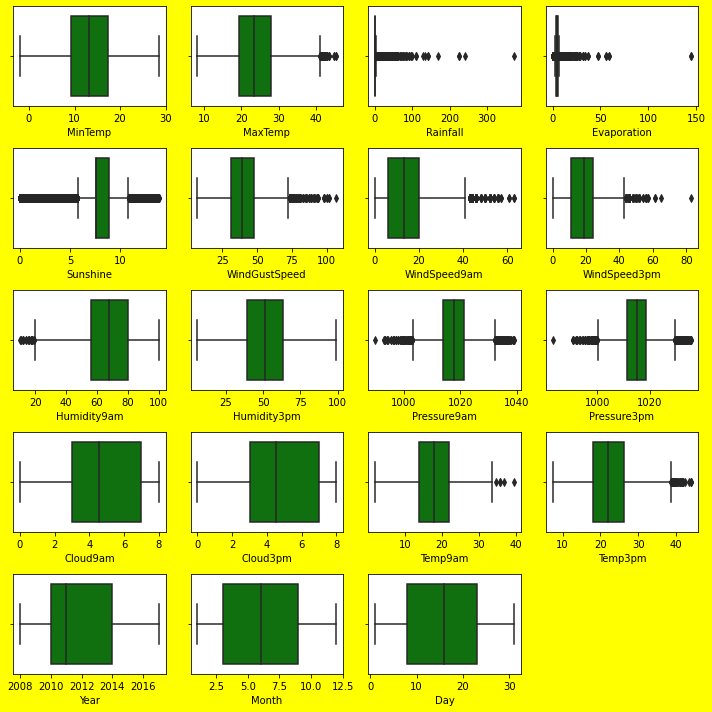

In [46]:
plt.figure(figsize=(10,10),facecolor='yellow')
graph=1 

for column in num_cols:

    plt.subplot(5,4,graph)

    sns.boxplot(df[column],color='green',orient='h')

    plt.xlabel(column,fontsize=10)

    graph+=1

    plt.tight_layout()

In [35]:
#rainfall is our target, so we wont remove outliers from it

out_cols = df[['MaxTemp','Evaporation','Sunshine','WindGustSpeed','WindSpeed9am','WindSpeed3pm',
              'Humidity9am','Pressure9am','Pressure3pm','Temp9am','Temp3pm']]
from scipy.stats import zscore

z=np.abs(zscore(out_cols))
df_new=df[(z<3).all(axis=1)]
df_new

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,Albury,13.4,22.900000,0.6,4.6,7.632205,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,No,No,2008,12,1
1,Albury,7.4,25.100000,0.0,4.6,7.632205,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,No,No,2008,12,2
2,Albury,12.9,25.700000,0.0,4.6,7.632205,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,No,No,2008,12,3
3,Albury,9.2,28.000000,0.0,4.6,7.632205,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,No,No,2008,12,4
4,Albury,17.5,32.300000,1.0,4.6,7.632205,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,No,No,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,Uluru,2.8,23.400000,0.0,4.6,7.632205,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,No,No,2017,6,21
8421,Uluru,3.6,25.300000,0.0,4.6,7.632205,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,No,No,2017,6,22
8422,Uluru,5.4,26.900000,0.0,4.6,7.632205,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,No,No,2017,6,23
8423,Uluru,7.8,27.000000,0.0,4.6,7.632205,SE,28.0,SSE,N,13.0,7.0,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,No,No,2017,6,24


In [36]:
print('old data shape:',df.shape)
print('new data shape:',df_new.shape)

old data shape: (8425, 25)
new data shape: (8095, 25)


In [37]:
#checking the loss percentage

loss_percentage=(((8425-8095)/8425)*100)
loss_percentage

3.9169139465875373

Since loss percentage is below 5% we can proceed.

## 2- Skewness

In [38]:
#checking the skewness

df_new.skew().sort_values()

Sunshine         -0.729992
Cloud9am         -0.364928
Cloud3pm         -0.273745
Humidity9am      -0.237214
MinTemp          -0.094538
Temp9am          -0.038715
Day               0.005967
Pressure9am       0.024754
Pressure3pm       0.047523
Month             0.059034
Humidity3pm       0.125872
WindSpeed3pm      0.301024
MaxTemp           0.321781
Temp3pm           0.341420
Year              0.430854
WindGustSpeed     0.542084
WindSpeed9am      0.714718
Evaporation       1.281752
Rainfall         13.877750
dtype: float64

In [39]:
#Using Power transformer to remove skewness in TotalCharges, we are not removing from target-rainfall

skew_cols=["Evaporation", "Sunshine", "WindGustSpeed", "WindSpeed9am"]

from sklearn.preprocessing import PowerTransformer
scaler = PowerTransformer(method='yeo-johnson')
df_new[skew_cols] = scaler.fit_transform(df_new[skew_cols].values)

In [40]:
#Checking the skewness again

df_new.skew()

MinTemp          -0.094538
MaxTemp           0.321781
Rainfall         13.877750
Evaporation       0.062599
Sunshine         -0.078349
WindGustSpeed     0.004802
WindSpeed9am     -0.110412
WindSpeed3pm      0.301024
Humidity9am      -0.237214
Humidity3pm       0.125872
Pressure9am       0.024754
Pressure3pm       0.047523
Cloud9am         -0.364928
Cloud3pm         -0.273745
Temp9am          -0.038715
Temp3pm           0.341420
Year              0.430854
Month             0.059034
Day               0.005967
dtype: float64

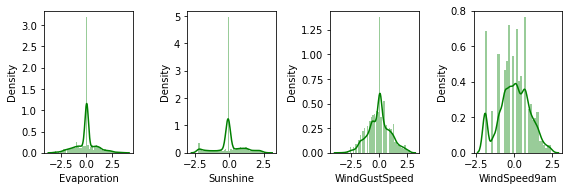

In [41]:
#plot for skewness check

plt.figure(figsize=(10,10))
graph=1 

for column in df_new[skew_cols]:

    plt.subplot(4,5,graph)

    sns.distplot(df_new[column],color='green')

    plt.xlabel(column,fontsize=10)

    graph+=1

    plt.tight_layout()

## 3-Encoding

In [47]:
#Encoding the categorical columns:

from sklearn.preprocessing import OrdinalEncoder
enc=OrdinalEncoder()

for i in cat_cols:
    df_new[i]=enc.fit_transform(df_new[i].values.reshape(-1,1))

In [48]:
#new encoded df

df_new

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,1.0,13.4,22.900000,0.6,0.031907,-0.084473,13.0,0.444328,13.0,14.0,0.781103,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,0.0,0.0,2008,12,1
1,1.0,7.4,25.100000,0.0,0.031907,-0.084473,14.0,0.444328,6.0,15.0,-0.985924,22.0,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,0.0,0.0,2008,12,2
2,1.0,12.9,25.700000,0.0,0.031907,-0.084473,15.0,0.589170,13.0,15.0,0.697109,26.0,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,0.0,0.0,2008,12,3
3,1.0,9.2,28.000000,0.0,0.031907,-0.084473,4.0,-1.255041,9.0,0.0,-0.066187,9.0,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,0.0,0.0,2008,12,4
4,1.0,17.5,32.300000,1.0,0.031907,-0.084473,13.0,0.220363,1.0,7.0,-0.543908,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,0.0,0.0,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9.0,2.8,23.400000,0.0,0.031907,-0.084473,0.0,-0.596582,9.0,1.0,0.143336,11.0,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,0.0,0.0,2017,6,21
8421,9.0,3.6,25.300000,0.0,0.031907,-0.084473,6.0,-1.461149,9.0,3.0,0.143336,9.0,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,0.0,0.0,2017,6,22
8422,9.0,5.4,26.900000,0.0,0.031907,-0.084473,3.0,-0.092204,9.0,14.0,-0.293406,9.0,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,0.0,0.0,2017,6,23
8423,9.0,7.8,27.000000,0.0,0.031907,-0.084473,9.0,-0.868112,10.0,3.0,0.143336,7.0,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,0.0,0.0,2017,6,24


In [49]:
df_new.dtypes

Location         float64
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir      float64
WindGustSpeed    float64
WindDir9am       float64
WindDir3pm       float64
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday        float64
RainTomorrow     float64
Year               int64
Month              int64
Day                int64
dtype: object

#### Our data is free from outliers, missing data imputed, skewness removed, and encoded. we are good to building the model.

## 4- Correlation

In [51]:
df_new.corr()   #lets check the correlation

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
Location,1.000000,0.112020,0.060569,0.001163,0.110600,0.043188,-0.037417,0.254394,-0.038655,-0.028622,0.239703,0.231936,0.003829,0.058170,-0.021382,-0.009228,0.040491,0.024564,0.113606,0.057378,0.001900,0.005620,0.483028,-0.085405,-0.005574
MinTemp,0.112020,1.000000,0.715527,0.089009,0.390106,0.078010,-0.153312,0.249476,-0.043406,-0.155134,0.163787,0.183462,-0.117147,0.097472,-0.432528,-0.426595,0.096184,0.043581,0.887828,0.684359,0.072772,0.097085,0.037568,-0.248316,0.009726
MaxTemp,0.060569,0.715527,1.000000,-0.083858,0.486081,0.400260,-0.235936,0.147772,-0.217509,-0.191687,0.018644,0.090108,-0.381825,-0.408248,-0.333274,-0.414642,-0.252614,-0.247465,0.863943,0.974833,-0.220169,-0.150898,0.117680,-0.163860,0.016155
Rainfall,0.001163,0.089009,-0.083858,1.000000,-0.044171,-0.158223,0.034949,0.076277,0.089969,0.034851,0.052271,0.019364,0.222707,0.233657,-0.051908,-0.011498,0.180878,0.150671,-0.002799,-0.087749,0.460519,0.216988,0.003416,-0.023102,-0.013951
Evaporation,0.110600,0.390106,0.486081,-0.044171,1.000000,0.405878,-0.111677,0.195821,-0.092123,-0.037519,0.128317,0.120630,-0.346406,-0.239679,-0.264854,-0.280545,-0.130506,-0.161161,0.464720,0.471074,-0.166639,-0.091700,0.102953,-0.041437,0.011218
Sunshine,0.043188,0.078010,0.400260,-0.158223,0.405878,1.000000,-0.112561,0.025577,-0.084572,-0.071883,0.020566,0.059658,-0.399141,-0.446316,-0.009144,-0.071808,-0.547470,-0.557970,0.278971,0.415488,-0.236940,-0.321344,0.029183,0.002032,0.004273
WindGustDir,-0.037417,-0.153312,-0.235936,0.034949,-0.111677,-0.112561,1.000000,0.011613,0.404689,0.507185,0.082351,0.106867,0.030921,0.049578,-0.096903,-0.010388,0.121865,0.092719,-0.184448,-0.247918,0.120523,0.042947,-0.094366,0.038607,0.018309
WindGustSpeed,0.254394,0.249476,0.147772,0.076277,0.195821,0.025577,0.011613,1.000000,-0.058899,0.082676,0.549562,0.637411,-0.268889,-0.081849,-0.371442,-0.328300,0.014778,0.064053,0.217792,0.113118,0.082734,0.177097,-0.031136,0.044598,-0.006114
WindDir9am,-0.038655,-0.043406,-0.217509,0.089969,-0.092123,-0.084572,0.404689,-0.058899,1.000000,0.245617,0.142960,0.059177,0.014449,0.119772,-0.004061,0.081765,0.095530,0.063381,-0.102193,-0.224366,0.154400,0.031332,-0.031335,0.017147,-0.011455
WindDir3pm,-0.028622,-0.155134,-0.191687,0.034851,-0.037519,-0.071883,0.507185,0.082676,0.245617,1.000000,0.042768,0.080043,-0.006699,-0.009685,-0.129253,-0.036654,0.072076,0.051984,-0.174254,-0.203442,0.099331,0.003747,-0.006997,0.030603,-0.000384


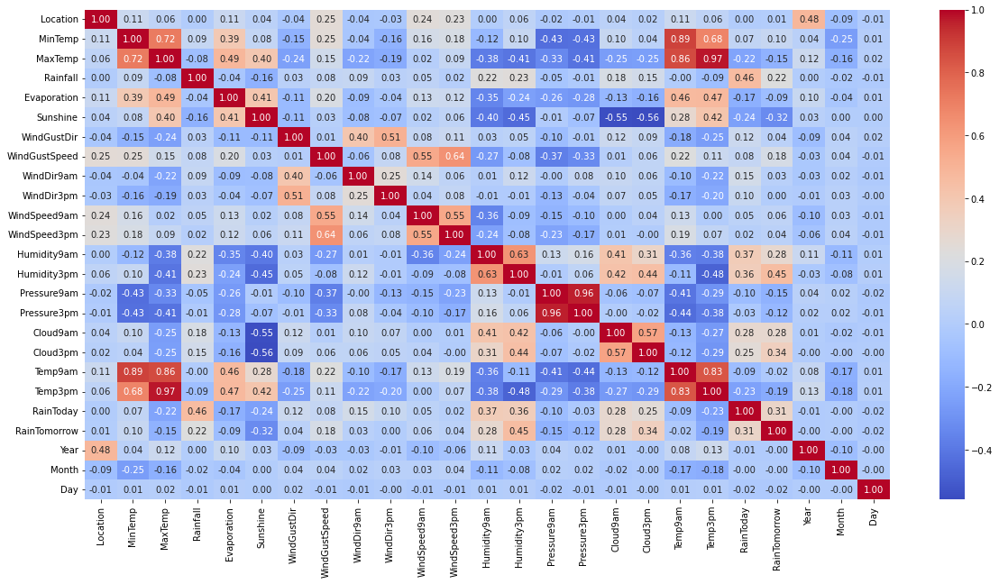

In [53]:
#Correlation Heat map

corr = df_new.corr()
plt.figure(figsize=(20,10), facecolor='white')
sns.heatmap(corr, annot=True,cmap='coolwarm',fmt='.2f')
plt.show()

We have multicollinearity. Our target Rainfall is highly correlated with RainToday and followed by Humidity 9am and Humidity 3pm. Least correlation is between rainfall and year,month,windspeen3pm,windspeed 9am,location.

In [54]:
corr['Rainfall'].sort_values(ascending=False)

Rainfall         1.000000
RainToday        0.460519
Humidity3pm      0.233657
Humidity9am      0.222707
RainTomorrow     0.216988
Cloud9am         0.180878
Cloud3pm         0.150671
WindDir9am       0.089969
MinTemp          0.089009
WindGustSpeed    0.076277
WindSpeed9am     0.052271
WindGustDir      0.034949
WindDir3pm       0.034851
WindSpeed3pm     0.019364
Year             0.003416
Location         0.001163
Temp9am         -0.002799
Pressure3pm     -0.011498
Day             -0.013951
Month           -0.023102
Evaporation     -0.044171
Pressure9am     -0.051908
MaxTemp         -0.083858
Temp3pm         -0.087749
Sunshine        -0.158223
Name: Rainfall, dtype: float64

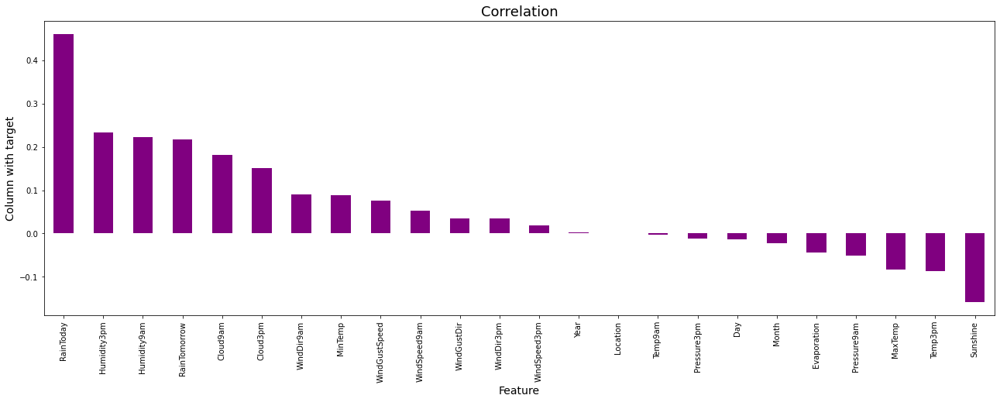

In [56]:
#Visualization of correlation:

plt.figure(figsize=(22,7))
df_new.corr()['Rainfall'].sort_values(ascending=False).drop(['Rainfall']).plot(kind='bar',color='purple')
plt.xlabel('Feature',fontsize=14)
plt.ylabel("Column with target",fontsize=14)
plt.title("Correlation",fontsize=18)
plt.show()

## 5- Data Splitting

In [109]:
#RainTomorrow as our target variable

x = df_new.drop("Rainfall",axis=1)
y = df_new["Rainfall"]

In [110]:
x

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,1.0,13.4,22.900000,0.031907,-0.084473,13.0,0.444328,13.0,14.0,0.781103,24.0,71.0,22.0,1007.7,1007.1,8.000000,4.503183,16.9,21.8,0.0,0.0,2008,12,1
1,1.0,7.4,25.100000,0.031907,-0.084473,14.0,0.444328,6.0,15.0,-0.985924,22.0,44.0,25.0,1010.6,1007.8,4.566622,4.503183,17.2,24.3,0.0,0.0,2008,12,2
2,1.0,12.9,25.700000,0.031907,-0.084473,15.0,0.589170,13.0,15.0,0.697109,26.0,38.0,30.0,1007.6,1008.7,4.566622,2.000000,21.0,23.2,0.0,0.0,2008,12,3
3,1.0,9.2,28.000000,0.031907,-0.084473,4.0,-1.255041,9.0,0.0,-0.066187,9.0,45.0,16.0,1017.6,1012.8,4.566622,4.503183,18.1,26.5,0.0,0.0,2008,12,4
4,1.0,17.5,32.300000,0.031907,-0.084473,13.0,0.220363,1.0,7.0,-0.543908,20.0,82.0,33.0,1010.8,1006.0,7.000000,8.000000,17.8,29.7,0.0,0.0,2008,12,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,9.0,2.8,23.400000,0.031907,-0.084473,0.0,-0.596582,9.0,1.0,0.143336,11.0,51.0,24.0,1024.6,1020.3,4.566622,4.503183,10.1,22.4,0.0,0.0,2017,6,21
8421,9.0,3.6,25.300000,0.031907,-0.084473,6.0,-1.461149,9.0,3.0,0.143336,9.0,56.0,21.0,1023.5,1019.1,4.566622,4.503183,10.9,24.5,0.0,0.0,2017,6,22
8422,9.0,5.4,26.900000,0.031907,-0.084473,3.0,-0.092204,9.0,14.0,-0.293406,9.0,53.0,24.0,1021.0,1016.8,4.566622,4.503183,12.5,26.1,0.0,0.0,2017,6,23
8423,9.0,7.8,27.000000,0.031907,-0.084473,9.0,-0.868112,10.0,3.0,0.143336,7.0,51.0,24.0,1019.4,1016.5,3.000000,2.000000,15.1,26.0,0.0,0.0,2017,6,24


In [111]:
y

0       0.6
1       0.0
2       0.0
3       0.0
4       1.0
       ... 
8420    0.0
8421    0.0
8422    0.0
8423    0.0
8424    0.0
Name: Rainfall, Length: 8095, dtype: float64

In [112]:
x.shape

(8095, 24)

In [113]:
y.shape

(8095,)

## 6- Standardization

In [114]:
#using Standard scaler to normalize the data

from sklearn.preprocessing import StandardScaler

ssc=StandardScaler()

x= pd.DataFrame(ssc.fit_transform(x), columns=x.columns)

In [115]:
x.head()

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year,Month,Day
0,-1.507825,0.049494,-0.142944,0.031907,-0.084473,1.228620,0.444328,1.243871,1.400572,0.781103,0.637677,0.169919,-1.628086,-1.686076,-1.400080,1.410357,0.002863,-0.139997,-0.095216,-0.558373,-0.553042,-1.659738,1.634617,-1.670812
1,-1.507825,-1.067884,0.224765,0.031907,-0.084473,1.441416,0.444328,-0.282945,1.627116,-0.985924,0.421359,-1.463293,-1.462825,-1.201338,-1.281876,-0.000555,0.002863,-0.085945,0.334508,-0.558373,-0.553042,-1.659738,1.634617,-1.557199
2,-1.507825,-0.043621,0.325049,0.031907,-0.084473,1.654213,0.589170,1.243871,1.627116,0.697109,0.853995,-1.826229,-1.187390,-1.702791,-1.129899,-0.000555,-1.085016,0.598719,0.145430,-0.558373,-0.553042,-1.659738,1.634617,-1.443585
3,-1.507825,-0.732671,0.709472,0.031907,-0.084473,-0.686548,-1.255041,0.371405,-1.771046,-0.066187,-0.984709,-1.402804,-1.958609,-0.031280,-0.437560,-0.000555,0.002863,0.076213,0.712666,-0.558373,-0.553042,-1.659738,1.634617,-1.329972
4,-1.507825,0.813035,1.428176,0.031907,-0.084473,1.228620,0.220363,-1.373528,-0.185237,-0.543908,0.205041,0.835302,-1.022129,-1.167908,-1.585830,0.999417,1.522573,0.022160,1.262713,-0.558373,-0.553042,-1.659738,1.634617,-1.216358


## 7- Multicollinearity

In [116]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

def vif_calc():
    vif=pd.DataFrame()
    vif["VIF Factor"]=[variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
    vif["features"]=x.columns
    print(vif)

In [117]:
vif_calc()

    VIF Factor       features
0     1.598054       Location
1     8.845080        MinTemp
2    26.238557        MaxTemp
3     1.598790    Evaporation
4     2.092265       Sunshine
5     1.611285    WindGustDir
6     2.370233  WindGustSpeed
7     1.362617     WindDir9am
8     1.489074     WindDir3pm
9     1.987651   WindSpeed9am
10    2.007337   WindSpeed3pm
11    4.001774    Humidity9am
12    5.706671    Humidity3pm
13   19.847474    Pressure9am
14   19.036781    Pressure3pm
15    1.957169       Cloud9am
16    1.847204       Cloud3pm
17   17.498336        Temp9am
18   33.086442        Temp3pm
19    1.396066      RainToday
20    1.458452   RainTomorrow
21    1.527218           Year
22    1.153525          Month
23    1.004819            Day


In [118]:
# Dropping Temp3pm column as it has highest VIF

x.drop("Temp3pm",axis=1,inplace=True)

In [119]:
vif_calc()

    VIF Factor       features
0     1.597341       Location
1     8.804005        MinTemp
2     9.602118        MaxTemp
3     1.598377    Evaporation
4     2.092252       Sunshine
5     1.607950    WindGustDir
6     2.360755  WindGustSpeed
7     1.361861     WindDir9am
8     1.487999     WindDir3pm
9     1.987631   WindSpeed9am
10    2.004651   WindSpeed3pm
11    3.548688    Humidity9am
12    3.940712    Humidity3pm
13   19.270187    Pressure9am
14   18.548308    Pressure3pm
15    1.955887       Cloud9am
16    1.837356       Cloud3pm
17   16.145400        Temp9am
18    1.395805      RainToday
19    1.458417   RainTomorrow
20    1.527045           Year
21    1.139312          Month
22    1.004409            Day


In [120]:
# Dropping pressure9am column as it has highest VIF

x.drop("Pressure9am",axis=1,inplace=True)

In [121]:
vif_calc()

    VIF Factor       features
0     1.597341       Location
1     8.681064        MinTemp
2     9.207475        MaxTemp
3     1.582941    Evaporation
4     2.083436       Sunshine
5     1.594046    WindGustDir
6     2.336924  WindGustSpeed
7     1.340541     WindDir9am
8     1.420133     WindDir3pm
9     1.983979   WindSpeed9am
10    1.991351   WindSpeed3pm
11    3.548085    Humidity9am
12    3.939751    Humidity3pm
13    1.448725    Pressure3pm
14    1.955440       Cloud9am
15    1.835328       Cloud3pm
16   16.092113        Temp9am
17    1.380578      RainToday
18    1.454226   RainTomorrow
19    1.525840           Year
20    1.138573          Month
21    1.003762            Day


In [122]:
# Dropping Temp9am column as it has highest VIF

x.drop("Temp9am",axis=1,inplace=True)

In [123]:
vif_calc()

    VIF Factor       features
0     1.595375       Location
1     4.547908        MinTemp
2     5.464186        MaxTemp
3     1.579405    Evaporation
4     2.075912       Sunshine
5     1.592040    WindGustDir
6     2.298867  WindGustSpeed
7     1.340420     WindDir9am
8     1.419585     WindDir3pm
9     1.963513   WindSpeed9am
10    1.944985   WindSpeed3pm
11    2.514464    Humidity9am
12    3.162263    Humidity3pm
13    1.445705    Pressure3pm
14    1.934004       Cloud9am
15    1.832221       Cloud3pm
16    1.376704      RainToday
17    1.454102   RainTomorrow
18    1.502378           Year
19    1.124796          Month
20    1.003575            Day


#### Multicollinearity is removed

In [126]:
x.head()

,Location,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure3pm,Cloud9am,Cloud3pm,RainToday,RainTomorrow,Year,Month,Day
0,-1.507825,0.049494,-0.142944,0.031907,-0.084473,1.228620,0.444328,1.243871,1.400572,0.781103,0.637677,0.169919,-1.628086,-1.400080,1.410357,0.002863,-0.558373,-0.553042,-1.659738,1.634617,-1.670812
1,-1.507825,-1.067884,0.224765,0.031907,-0.084473,1.441416,0.444328,-0.282945,1.627116,-0.985924,0.421359,-1.463293,-1.462825,-1.281876,-0.000555,0.002863,-0.558373,-0.553042,-1.659738,1.634617,-1.557199
2,-1.507825,-0.043621,0.325049,0.031907,-0.084473,1.654213,0.589170,1.243871,1.627116,0.697109,0.853995,-1.826229,-1.187390,-1.129899,-0.000555,-1.085016,-0.558373,-0.553042,-1.659738,1.634617,-1.443585
3,-1.507825,-0.732671,0.709472,0.031907,-0.084473,-0.686548,-1.255041,0.371405,-1.771046,-0.066187,-0.984709,-1.402804,-1.958609,-0.437560,-0.000555,0.002863,-0.558373,-0.553042,-1.659738,1.634617,-1.329972
4,-1.507825,0.813035,1.428176,0.031907,-0.084473,1.228620,0.220363,-1.373528,-0.185237,-0.543908,0.205041,0.835302,-1.022129,-1.585830,0.999417,1.522573,-0.558373,-0.553042,-1.659738,1.634617,-1.216358


In [127]:
x.shape

(8095, 21)

# Building the Model

In [89]:
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import ElasticNet
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.linear_model import SGDRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.model_selection import GridSearchCV 
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

### 1- Linear Regression

In [128]:
#Selecting the best random state to get maximum accuracy.
max_acc=0
max_RS=0
for i in range(1,100):
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=i)
    lr= LinearRegression()
    lr.fit(x_train,y_train)
    pred = lr.predict(x_test)
    acc = r2_score(y_test, pred)
    if acc > max_acc:
        max_acc= acc
        max_RS=i
print("The max accuracy is",max_acc, 'seen for random state:',max_RS)

The max accuracy is 0.34530793003163185 seen for random state: 47


In [129]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=max_RS)
lm = LinearRegression()
lm.fit(x_train, y_train)
y_pred = lm.predict(x_test)

print('The r2 score is:', r2_score(y_test, y_pred))
print('The mean absolute error', mean_absolute_error(y_test, y_pred))
print('The mean squared error', mean_squared_error(y_test, y_pred))

The r2 score is: 0.34530793003163185
The mean absolute error 2.904268638915705
The mean squared error 43.16495845536115


In [130]:
#Hyperparameter tuning for Linear Regression

par_grid =  {'fit_intercept':[True,False], 'normalize':[True,False], 'copy_X':[True, False]}
grid_lm = GridSearchCV(estimator=lm, param_grid=par_grid, cv=5,n_jobs=1, verbose=1)

grid_lm.fit(x_train, y_train)
print("The best estimators:", grid_lm.best_estimator_)
print("The best score:", grid_lm.best_score_)
print("The best parameters:", grid_lm.best_params_)

Fitting 5 folds for each of 8 candidates, totalling 40 fits
The best estimators: LinearRegression(normalize=True)
The best score: 0.2102888613058475
The best parameters: {'copy_X': True, 'fit_intercept': True, 'normalize': True}


In [131]:
#RE INSTANTIATING WITH BEST PARAMETERS

grid_lm = LinearRegression(copy_X=True, fit_intercept=True, normalize=True)
grid_lm.fit(x_train, y_train)
y_pred1 = lm.predict(x_test)

print('The r2 score is:', r2_score(y_test, y_pred1))
print('The mean absolute error', mean_absolute_error(y_test, y_pred1))
print('The mean squared error', mean_squared_error(y_test, y_pred1))

The r2 score is: 0.34530793003163185
The mean absolute error 2.904268638915705
The mean squared error 43.16495845536115


#### Score is same after tuning

Text(0, 0.5, 'Predicted Y')

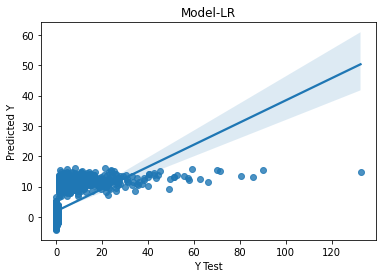

In [132]:
sns.regplot(x=y_test,y=y_pred1)
plt.title("Model-LR")
plt.xlabel('Y Test')
plt.ylabel('Predicted Y')

#### bad plot and model

### 2- Ridge Regularization

In [133]:
#Selecting the best random state to get maximum accuracy.
max_acc=0
max_RS=0
for i in range(1,100):
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=i)
    Rd = Ridge()
    Rd.fit(x_train,y_train)
    pred = Rd.predict(x_test)
    acc = r2_score(y_test, pred)
    if acc > max_acc:
        max_acc= acc
        max_RS=i
print("The max accuracy is",max_acc, 'seen for random state:',max_RS)

The max accuracy is 0.34531417561683053 seen for random state: 47


In [134]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=max_RS)
pred = Rd.predict(x_test)
print('The r2 score is:', r2_score(y_test, pred))
print('The mean absolute error', mean_absolute_error(y_test, pred))
print('The mean squared error', mean_squared_error(y_test, pred))
cv = cross_val_score(Rd, x,y,cv=5)
print('The cross validation score', cv.mean())

The r2 score is: 0.34782665552783154
The mean absolute error 2.919708021470777
The mean squared error 42.998894611928364
The cross validation score 0.2428989035312757


Text(0, 0.5, 'Predicted Y')

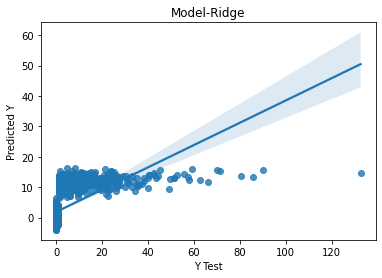

In [135]:
sns.regplot(x=y_test,y=pred)
plt.title("Model-Ridge")
plt.xlabel('Y Test')
plt.ylabel('Predicted Y')

#### Not a good model

### 3- KNN Regressor

In [136]:
#Selecting the best random state to get maximum accuracy.
max_acc=0
max_RS=0
for i in range(1,100):
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=i)
    knn = KNeighborsRegressor()
    knn.fit(x_train,y_train)
    pred = knn.predict(x_test)
    acc = r2_score(y_test, pred)
    if acc > max_acc:
        max_acc= acc
        max_RS=i
print("The max accuracy is",max_acc, 'seen for random state:',max_RS)

The max accuracy is 0.33895549939408565 seen for random state: 81


In [137]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=max_RS)

knn = KNeighborsRegressor()
knn.fit(x_train,y_train)
pred_knn = knn.predict(x_test)
print('The r2 score is:', r2_score(y_test, pred_knn))
print('The mean absolute error', mean_absolute_error(y_test, pred_knn))
print('The mean squared error', mean_squared_error(y_test, pred_knn))
print('root_mean_squared_error:',np.sqrt(mean_squared_error(y_test,pred_knn)))

The r2 score is: 0.33895549939408565
The mean absolute error 2.007632770687526
The mean squared error 42.26961070399341
root_mean_squared_error: 6.501508340684753


In [138]:
#Hyperparameter tuning of KNN

x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=max_RS)

knn = KNeighborsRegressor()
knn_grid_param={"n_neighbors": [3,5,7],
                "weights": ["uniform","distance"],
                'metric' : ['minkowski','euclidean','manhattan'],
               'algorithm':['auto', 'ball_tree', 'kd_tree', 'brute']}

gd_sr=GridSearchCV(estimator=knn,param_grid=knn_grid_param,scoring='r2',cv=5)

gd_sr.fit(x,y)

best_parameters=gd_sr.best_params_
print(best_parameters)

print(gd_sr.best_score_)

{'algorithm': 'auto', 'metric': 'manhattan', 'n_neighbors': 7, 'weights': 'distance'}
0.4488876273097978


In [139]:
#Reinstating with best params:

x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=max_RS)
knn_H = KNeighborsRegressor(algorithm='auto',metric='manhattan',n_neighbors=7,weights='distance')
knn_H.fit(x_train,y_train)
predknn = knn_H.predict(x_test)

print('The r2 score is:', r2_score(y_test, predknn))
print('The mean absolute error', mean_absolute_error(y_test, predknn))
print('The mean squared error', mean_squared_error(y_test, predknn))

The r2 score is: 0.5071567481357853
The mean absolute error 1.540531290384516
The mean squared error 31.514205738487533


#### Score is improved

Text(0, 0.5, 'Predicted Y')

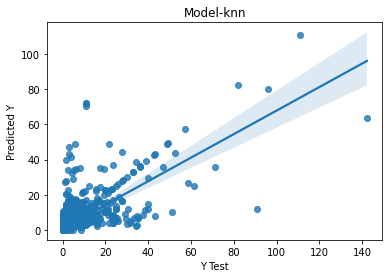

In [140]:
#plotting regplot 

sns.regplot(x=y_test,y=predknn)
plt.title("Model-knn")
plt.xlabel('Y Test')
plt.ylabel('Predicted Y')

Not a good model

### 4- Random Forest Regressor

In [193]:
#Selecting the best random state to get maximum accuracy.
max_acc=0
max_RS=0
for i in range(1,100):
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=i)
    rdf = RandomForestRegressor()
    rdf.fit(x_train,y_train)
    pred = rdf.predict(x_test)
    acc = r2_score(y_test, pred)
    if acc > max_acc:
        max_acc= acc
        max_RS=i
print("The max accuracy is",max_acc, 'seen for random state:',max_RS)

The max accuracy is 0.6114900472704552 seen for random state: 37


In [142]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=max_RS)
rdf = RandomForestRegressor()
rdf.fit(x_train,y_train)
pred_rdf = rdf.predict(x_test)

print('The r2 score is:', r2_score(y_test, pred_rdf))
print('The mean absolute error', mean_absolute_error(y_test, pred_rdf))
print('The mean squared error', mean_squared_error(y_test, pred_rdf))
print('root_mean_squared_error:',np.sqrt(mean_squared_error(y_test,pred_rdf)))

The r2 score is: 0.6221402621567352
The mean absolute error 1.7223804034582133
The mean squared error 31.28425406669411
root_mean_squared_error: 5.593232881500118


In [143]:
#HyperParameter Tuning for Random Forest Regressor

from sklearn.model_selection import RandomizedSearchCV

parameters={'min_samples_split':[5,10,15,100],
            'n_estimators':[100,200,300,400],
            'max_depth': [5,6,7,8,10,30],
            'max_features':['sqrt','log2',None]}

g=RandomizedSearchCV(RandomForestRegressor(),param_distributions = parameters,scoring='r2',
                     cv = 5, n_iter = 10, n_jobs=-1)
g.fit(x_train,y_train)
pred_g=g.predict(x_test)
print('The r2 score is:', r2_score(y_test, pred_g))
print("\n The best estimator across ALL searched params:\n", g.best_estimator_)
print("\n The best score across ALL searched params:\n", g.best_score_)
print("\n The best parameters across ALL searched params:\n",g.best_params_)

The r2 score is: 0.5295204757112189

 The best estimator across ALL searched params:
 RandomForestRegressor(max_depth=10, max_features='sqrt', min_samples_split=10,
                      n_estimators=400)

 The best score across ALL searched params:
 0.33330358311457536

 The best parameters across ALL searched params:
 {'n_estimators': 400, 'min_samples_split': 10, 'max_features': 'sqrt', 'max_depth': 10}


In [148]:
#reinstating with tuned parameters
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=max_RS)
rdf_H = RandomForestRegressor(max_depth=10,max_features='sqrt',min_samples_split= 10,
                              n_estimators=400)
rdf_H.fit(x_train,y_train)
predrdf = rdf_H.predict(x_test)
print('The r2 score is:', r2_score(y_test, predrdf))
print('The mean absolute error', mean_absolute_error(y_test, predrdf))
print('The mean squared error', mean_squared_error(y_test, predrdf))
print('root_mean_squared_error:',np.sqrt(mean_squared_error(y_test,predrdf)))

The r2 score is: 0.5300629429012288
The mean absolute error 2.0199732477324575
The mean squared error 38.907639044969365
root_mean_squared_error: 6.237598820457225


#### Score is not improved

Text(0, 0.5, 'Predicted Y')

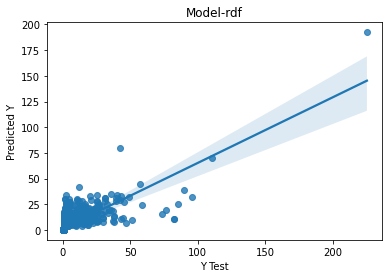

In [149]:
sns.regplot(x=y_test,y=pred_rdf)
plt.title("Model-rdf")
plt.xlabel('Y Test')
plt.ylabel('Predicted Y')

### 5- XGB Regressor

In [108]:
from xgboost import XGBRegressor

#Selecting the best random state to get maximum accuracy.
max_acc=0
max_RS=0
for i in range(1,100):
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=i)
    XGB=XGBRegressor()
    XGB.fit(x_train,y_train)
    xgb_pred=XGB.predict(x_test)
    acc = r2_score(y_test, xgb_pred)
    if acc > max_acc:
        max_acc= acc
        max_RS=i
print("The max accuracy is",max_acc, 'seen for random state:',max_RS)

The max accuracy is 0.6056454842717093 seen for random state: 12


In [150]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=max_RS)
XGB=XGBRegressor()
XGB.fit(x_train,y_train)
xgb_pred=XGB.predict(x_test)
print('The r2 score is:', r2_score(y_test,xgb_pred))
print('The mean squared error', mean_squared_error(y_test,xgb_pred))
print('The mean absolute error', mean_absolute_error(y_test,xgb_pred))
print('root_mean_squared_error:',np.sqrt(mean_squared_error(y_test,xgb_pred)))

The r2 score is: 0.6042741458814647
The mean squared error 32.763448764522714
The mean absolute error 1.7986431661812101
root_mean_squared_error: 5.723936474535922


In [151]:
param_grid = dict(learning_rate=[0.01, 0.03, 0.05, 0.1], max_depth=[5, 7, 10], 
                  n_estimators=[100, 200,300],gamma=[0.05, 0.5],
                  reg_alpha=[0, 0.5],reg_lambda=[1, 0])

model = XGBRegressor(random_state=max_RS, verbosity=1)

grid_search = GridSearchCV(estimator=model,
                           param_grid=param_grid,
                           scoring='r2')

best_model = grid_search.fit(x_train, y_train)
print('Optimum parameters', best_model.best_params_)

Optimum parameters {'gamma': 0.5, 'learning_rate': 0.05, 'max_depth': 5, 'n_estimators': 300, 'reg_alpha': 0.5, 'reg_lambda': 1}


In [155]:
#reinstating with tuned param:

XGB_H=XGBRegressor(learning_rate=0.05,max_depth=5,n_estimators=300,
                   reg_alpha=0.5,reg_lambda=1,gamma=0.5)
XGB_H.fit(x_train,y_train)
xgbpred=XGB_H.predict(x_test)
print('The r2 score is:', r2_score(y_test,xgbpred))
print('The mean squared error', mean_squared_error(y_test,xgbpred))
print('The mean absolute error', mean_absolute_error(y_test,xgbpred))
print('root_mean_squared_error:',np.sqrt(mean_squared_error(y_test,xgbpred)))

The r2 score is: 0.5882972689734027
The mean squared error 34.086227103482535
The mean absolute error 1.9039384087178228
root_mean_squared_error: 5.838341125994826


#### Score is not good

Text(0, 0.5, 'Predicted Y')

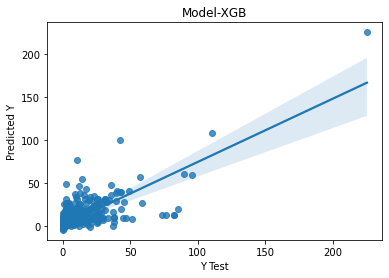

In [156]:
sns.regplot(x=y_test,y=xgb_pred)
plt.title("Model-XGB")
plt.xlabel('Y Test')
plt.ylabel('Predicted Y')

### 6- gradient Boosting Regressor

In [157]:
#Selecting the best random state to get maximum accuracy.

from sklearn.ensemble import GradientBoostingRegressor
max_acc=0
max_RS=0
for i in range(1,100):
    x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=i)
    GBR=GradientBoostingRegressor()
    GBR.fit(x_train,y_train)
    pred=GBR.predict(x_test)
    acc = r2_score(y_test, pred)
    if acc > max_acc:
        max_acc= acc
        max_RS=i
print("The max accuracy is",max_acc, 'seen for random state:',max_RS)

The max accuracy is 0.5365359349516654 seen for random state: 37


In [167]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=max_RS)

GBR=GradientBoostingRegressor()
GBR.fit(x_train,y_train)
pred_gbr=GBR.predict(x_test)
print('R2_score:',r2_score(y_test,pred_gbr))
print('mean_squared_error:',mean_squared_error(y_test,pred_gbr))
print('mean_absolute_error:',mean_absolute_error(y_test,pred_gbr))
print('root_mean_squared_error:',np.sqrt(mean_squared_error(y_test,pred_gbr)))

R2_score: 0.5365482573368672
mean_squared_error: 33.39966107301706
mean_absolute_error: 2.114839042844463
root_mean_squared_error: 5.779243988015825


Text(0, 0.5, 'Predicted Y')

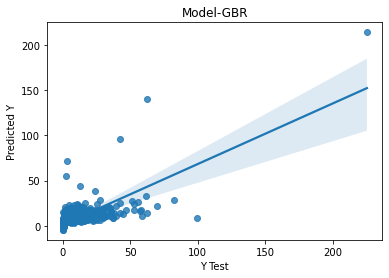

In [159]:
#plotting regplot

sns.regplot(x=y_test,y=pred_gbr)
plt.title("Model-GBR")
plt.xlabel('Y Test')
plt.ylabel('Predicted Y')

## Cross Validation Score

In [160]:
cv = cross_val_score(lm, x,y,cv=5)
print('The cross validation score', cv.mean())

The cross validation score 0.24289300490919574


In [161]:
cv = cross_val_score(Rd, x,y,cv=5)
print('The cross validation score', cv.mean())

The cross validation score 0.2428989035312757


In [162]:
cv = cross_val_score(knn_H, x,y,cv=5)
print('The cross validation score', cv.mean())

The cross validation score 0.4488876273097978


In [163]:
cv = cross_val_score(rdf_H, x,y,cv=5)
print('The cross validation score', cv.mean())

The cross validation score 0.41323446442026784


In [164]:
cv = cross_val_score(XGB, x,y,cv=5)
print('The cross validation score', cv.mean())

The cross validation score 0.3756838686797989


In [165]:
cv = cross_val_score(GBR, x,y,cv=5)
print('The cross validation score', cv.mean())

The cross validation score 0.3609310377832331


In [166]:
np.random.seed(10)
def rmse_cv(model, x,y):
    rmse =- (cross_val_score(model, x,y, scoring='neg_mean_squared_error', cv=5))
    return(rmse)


models = [LinearRegression(),Ridge(),KNeighborsRegressor(),RandomForestRegressor(),
          XGBRegressor(),GradientBoostingRegressor(),]
            
names = ['LR','Rd','knn','rdf','xgb','gbr']

for model,name in zip(models,names):
    score = rmse_cv(model,x,y)
    print("{}    : {:.6f}, {:4f}".format(name,score.mean(),score.std()))

LR    : 80.993806, 45.014096
Rd    : 80.993658, 45.014930
knn    : 76.311783, 44.177900
rdf    : 62.816069, 46.097265
xgb    : 68.008983, 49.512561
gbr    : 69.028984, 46.374210


### I am takinf rdf as Final model after considering R2 score and cv score.

## Saving the Final Model

In [197]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=63)
Final_model = RandomForestRegressor()
Final_model.fit(x_train,y_train)
pred_xgb = Final_model.predict(x_test)
print('The r2 score is:', r2_score(y_test, pred_xgb))
print('The mean absolute error', mean_absolute_error(y_test, pred_xgb))
print('The mean squared error', mean_squared_error(y_test, pred_xgb))
print('root_mean_squared_error:',np.sqrt(mean_squared_error(y_test,pred_xgb)))

The r2 score is: 0.6149006419868382
The mean absolute error 1.7306405928365585
The mean squared error 31.883646100452857
root_mean_squared_error: 5.646560554926588


In [198]:
# Saving the model using .pkl

import joblib
joblib.dump(Final_model,"Rainfall_prediction.pkl")

['Rainfall_prediction.pkl']

## Predictions

In [199]:
#load the model
model=joblib.load("Rainfall_prediction.pkl")

#Prediction
prediction = model.predict(x_test)
prediction

array([8.21 , 0.044, 0.02 , ..., 0.104, 6.811, 0.026])

In [200]:
base = pd.DataFrame()
base["actual"] = y_test
base["predictions"] = prediction
base

,actual,predictions
2356,2.4,8.210
1064,0.0,0.044
1655,0.0,0.020
3611,0.0,0.032
7913,0.0,0.000
...,...,...
2830,1.8,5.018
6439,0.0,0.218
1051,0.0,0.104
633,9.6,6.811


#### These are the actual and predicted values.